<a href="https://colab.research.google.com/github/Narissarach/Project_eye/blob/main/2022project1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import PIL
import time
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import numpy as np
import pickle as p
import plotly
from tensorflow.keras.models import load_model
from tensorflow.keras.models import model_from_json
import plotly.graph_objs as go
from tensorflow import keras
from tensorflow.keras.models import Sequential

## เตรียมชุดของข้อมูล

In [2]:
from google.colab import drive # เชื่อม drive ของเรา ถ้าเชื่อมสำเร็จจะขึ้นคำว่า Mounted at /content/drive 
drive.mount('/content/drive')
path = '/content/drive/My Drive/2022Project/dataeye'  # ชี้ว่า data เราอยู่โฟล์เดอร์ไหน

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import pathlib
data_dir = pathlib.Path('/content/drive/My Drive/2022Project/dataeye')

In [4]:
batch_size = 64   # กำหนดขนาดของแต่ละการอ่านข้อมูล
img_height = 224  # ความสูงของรูปภาพแต่ละรูป
img_width = 224   # ความกว้างของรูปภาพแต่ละรูป

## Train

In [5]:
train = tf.keras.preprocessing.image_dataset_from_directory(data_dir,
validation_split=0.1, # s แบ่งข้อมูล เพื่อ training 90% และ validation 10%
subset="training",
seed=123,
image_size=(img_height, img_width),
batch_size=batch_size)
val = tf.keras.preprocessing.image_dataset_from_directory(
data_dir,
validation_split=0.1,
subset="validation",
seed=123,
image_size=(img_height, img_width),
batch_size=batch_size)

Found 16556 files belonging to 3 classes.
Using 14901 files for training.
Found 16556 files belonging to 3 classes.
Using 1655 files for validation.


In [6]:
class_names = train.class_names
print(class_names)

['Crop CSC', 'Crop PCV', 'Crop VKH']


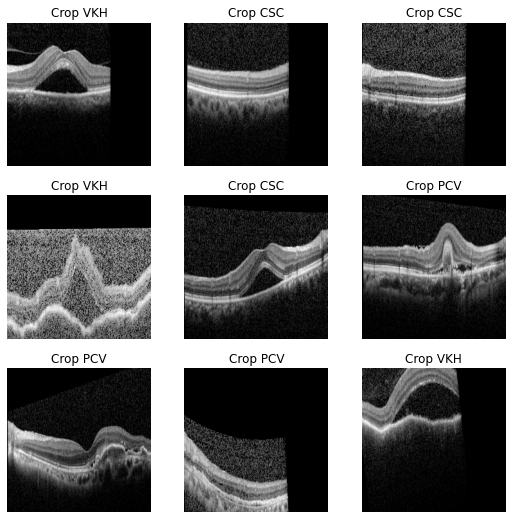

In [7]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9, 9)) #ขนาด
for images, labels in train.take(1):
  for i in range(9): #มี 9 รูป
    ax = plt.subplot(3, 3, i + 1) #แถวละ 3
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [8]:
for image_batch, labels_batch in train:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(64, 224, 224, 3)
(64,)


## Normalization

In [9]:
normalization_layer = layers.experimental.preprocessing.Rescaling(1./255)
normalized_ds = train.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
print(np.min(first_image), np.max(first_image))

0.0 0.99369746


## Model

In [10]:
num_classes = 3
epochs=10   # จำนวนครั้งที่เราจะ Train

In [11]:
model = Sequential([
layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
layers.Conv2D(16, 3, padding='same', activation='relu'),
layers.MaxPooling2D(),
layers.Conv2D(32, 3, padding='same', activation='relu'),
layers.MaxPooling2D(),
layers.Conv2D(64, 3, padding='same', activation='relu'),
layers.MaxPooling2D(),
layers.Flatten(),
layers.Dense(128, activation='relu'),
layers.Dense(num_classes)
])

In [12]:
model.compile(optimizer='adam',
loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 56, 56, 64)        1

In [13]:
his = model.fit(
train,
validation_data=val,
epochs=epochs
)

Epoch 1/10
233/233 [==============================] - 2748s 12s/step - loss: 0.9225 - accuracy: 0.5614 - val_loss: 0.6106 - val_accuracy: 0.7335
Epoch 2/10
233/233 [==============================] - 132s 546ms/step - loss: 0.4556 - accuracy: 0.8197 - val_loss: 0.3998 - val_accuracy: 0.8411
Epoch 3/10
233/233 [==============================] - 132s 550ms/step - loss: 0.2223 - accuracy: 0.9199 - val_loss: 0.2942 - val_accuracy: 0.8846
Epoch 4/10
233/233 [==============================] - 129s 537ms/step - loss: 0.0962 - accuracy: 0.9670 - val_loss: 0.2202 - val_accuracy: 0.9269
Epoch 5/10
233/233 [==============================] - 127s 533ms/step - loss: 0.0492 - accuracy: 0.9819 - val_loss: 0.2364 - val_accuracy: 0.9299
Epoch 6/10
233/233 [==============================] - 129s 540ms/step - loss: 0.0318 - accuracy: 0.9893 - val_loss: 0.2189 - val_accuracy: 0.9293
Epoch 7/10
233/233 [==============================] - 127s 528ms/step - loss: 0.0131 - accuracy: 0.9963 - val_loss: 0.2563 - 

## Save Model

In [14]:
with open('history_model', 'wb') as file:
   p.dump(his.history, file)

filepath='model1.h5'
model.save(filepath)
filepath_model = 'model1.json'
filepath_weights = 'weights_model.h5'
model_json = model.to_json()
with open(filepath_model, "w") as json_file:
   json_file.write(model_json)

model.save_weights('weights_model.h5')
print("Saved model to disk")

Saved model to disk


## Load Model

In [15]:
with open('history_model', 'rb') as file:
   his = p.load(file)

h1 = go.Scatter(y=his['loss'],
mode="lines", line=dict(
width=2,
color='blue'),
name="loss"
)
h2 = go.Scatter(y=his['val_loss'],
mode="lines", line=dict(
width=2,
color='red'),
name="val_loss"
)

data = [h1,h2]
layout1 = go.Layout(title='Loss',
xaxis=dict(title='epochs'),
yaxis=dict(title=' '))
fig1 = go.Figure(data, layout=layout1)
plotly.offline.iplot(fig1, filename="testMNIST")
predict_model = load_model(filepath)
predict_model.summary()
with open(filepath_model, 'r') as f:
   loaded_model_json = f.read()
predict_model = model_from_json(loaded_model_json)
predict_model.load_weights(filepath_weights)
print("Loaded model from disk")

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 56, 56, 64)        1

## Prediction

1/1 [==============================] - 0s 16ms/step
Crop CSC tf.Tensor(1.0, shape=(), dtype=float32) Crop PCV tf.Tensor(8.354073e-15, shape=(), dtype=float32) Crop VKH tf.Tensor(4.2169607e-13, shape=(), dtype=float32)


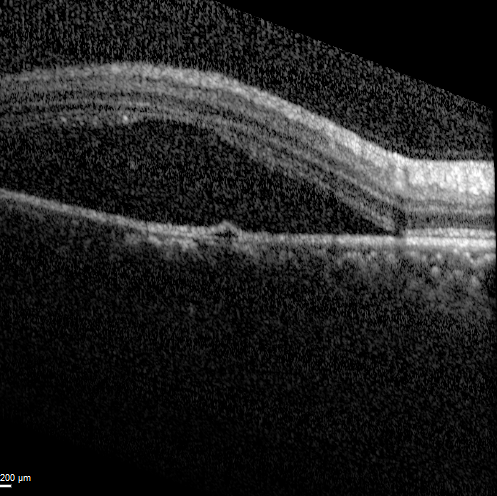

AI Crop CSC มีความมั่นใจ 100.00%.


In [18]:
import requests
from IPython.display import Image
from io import BytesIO
test_path = ('/content/drive/My Drive/testeye/testc.png')
img = keras.preprocessing.image.load_img(
test_path, target_size=(img_height, img_width)
)
img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch
predictions = predict_model.predict(img_array)
score = tf.nn.softmax(predictions[0])
print("Crop CSC",score[0],"Crop PCV",score[1],"Crop VKH",score[2])
display(Image(filename=test_path,width=180, height=180))
if score[0]==np.max(score) :
   fruit = "Crop CSC"
elif score[1]==np.max(score) :
   fruit = "Crop PCV"
elif score[2]==np.max(score) :
   fruit = "Crop VKH"
print(
"AI {} มีความมั่นใจ {:.2f}%."
.format(fruit, 100 * np.max(score))
)

1/1 [==============================] - 0s 18ms/step
Crop CSC tf.Tensor(0.33671916, shape=(), dtype=float32) Crop PCV tf.Tensor(0.66328037, shape=(), dtype=float32) Crop VKH tf.Tensor(5.243477e-07, shape=(), dtype=float32)


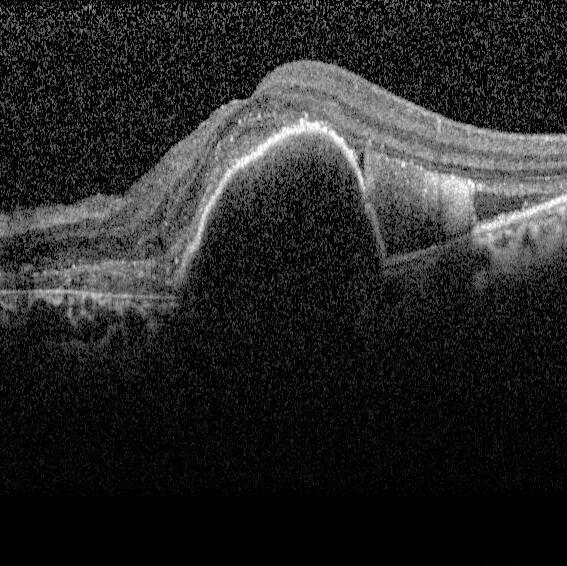

AI Crop PCV มีความมั่นใจ 66.33%.


In [19]:
test_path = ('/content/drive/My Drive/testeye/testp.jpg')
img = keras.preprocessing.image.load_img(
test_path, target_size=(img_height, img_width)
)
img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch
predictions = predict_model.predict(img_array)
score = tf.nn.softmax(predictions[0])
print("Crop CSC",score[0],"Crop PCV",score[1],"Crop VKH",score[2])
display(Image(filename=test_path,width=180, height=180))
if score[0]==np.max(score) :
   fruit = "Crop CSC"
elif score[1]==np.max(score) :
   fruit = "Crop PCV"
elif score[2]==np.max(score) :
   fruit = "Crop VKH"
print(
"AI {} มีความมั่นใจ {:.2f}%."
.format(fruit, 100 * np.max(score))
)

1/1 [==============================] - 0s 19ms/step
Crop CSC tf.Tensor(0.8907548, shape=(), dtype=float32) Crop PCV tf.Tensor(0.10918108, shape=(), dtype=float32) Crop VKH tf.Tensor(6.3991894e-05, shape=(), dtype=float32)


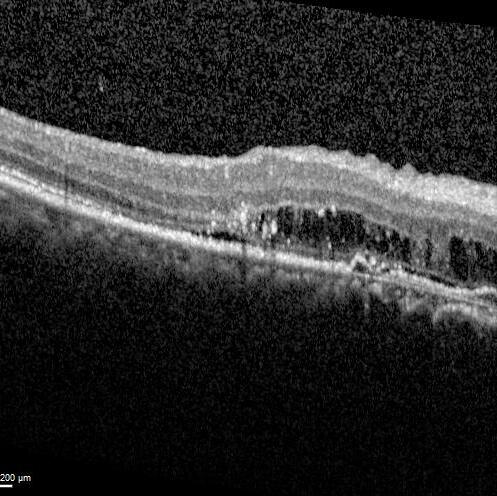

AI Crop CSC มีความมั่นใจ 89.08%.


In [20]:
test_path = ('/content/drive/My Drive/testeye/testv.jpg')
img = keras.preprocessing.image.load_img(
test_path, target_size=(img_height, img_width)
)
img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch
predictions = predict_model.predict(img_array)
score = tf.nn.softmax(predictions[0])
print("Crop CSC",score[0],"Crop PCV",score[1],"Crop VKH",score[2])
display(Image(filename=test_path,width=180, height=180))
if score[0]==np.max(score) :
   fruit = "Crop CSC"
elif score[1]==np.max(score) :
   fruit = "Crop PCV"
elif score[2]==np.max(score) :
   fruit = "Crop VKH"
print(
"AI {} มีความมั่นใจ {:.2f}%."
.format(fruit, 100 * np.max(score))
)

# Test

In [21]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import numpy as np
from os import listdir
from os.path import isfile, join
import matplotlib.pyplot as plt

In [23]:
# dimensions of our images
img_width, img_height = 224, 224

# Load the model we save
model = load_model('model1.h5')

['CD7445 30-06-16 LE_000000_cropped.png', 'CD7445 30-06-16 LE_000003_cropped.png', 'CD7445 30-06-16 LE_000006_cropped.png', 'CD7445 30-06-16 LE_000001_cropped.png', 'CD7445 30-06-16 LE_000016_cropped.png', 'CD7445 30-06-16 LE_000009_cropped.png', 'CD7445 30-06-16 LE_000004_cropped.png', 'CD7445 30-06-16 LE_000005_cropped.png', 'CD7445 30-06-16 LE_000007_cropped.png', 'CD7445 30-06-16 LE_000019_cropped.png', 'CD7445 30-06-16 LE_000008_cropped.png', 'CD7445 30-06-16 LE_000020_cropped.png', 'CD7445 30-06-16 LE_000018_cropped.png', 'CD7445 30-06-16 LE_000015_cropped.png', 'CD7445 30-06-16 LE_000023_cropped.png', 'CD7445 30-06-16 LE_000002_cropped.png', 'CD7445 30-06-16 LE_000014_cropped.png', 'CD7445 30-06-16 LE_000017_cropped.png', 'CD7445 30-06-16 LE_000013_cropped.png', 'CD7445 30-06-16 LE_000010_cropped.png', 'CD7445 30-06-16 LE_001000_cropped.png', 'CD7445 30-06-16 LE_000011_cropped.png', 'CD7445 30-06-16 LE_000012_cropped.png', 'CD7445 30-06-16 LE_002_cropped.png', 'CD7445 30-06-16 L

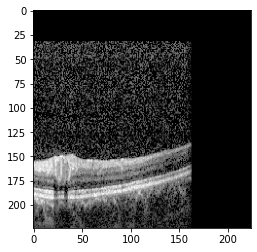

1/1 [==============================] - 0s 131ms/step
[[-2.5242548 -2.8914695  3.9598198]]
Crop VKH , 395.98
CD7445 30-06-16 LE_000000_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000003_cropped.png


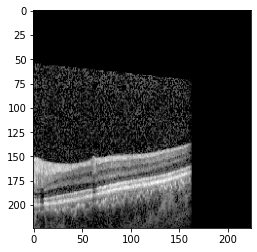

1/1 [==============================] - 0s 18ms/step
[[-2.515056  -2.8812668  3.9464214]]
Crop VKH , 394.64
CD7445 30-06-16 LE_000003_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000006_cropped.png


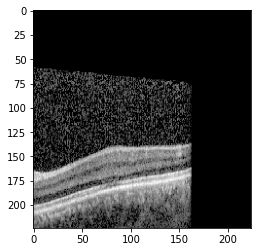

1/1 [==============================] - 0s 18ms/step
[[-2.5129702 -2.8838854  3.9483292]]
Crop VKH , 394.83
CD7445 30-06-16 LE_000006_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000001_cropped.png


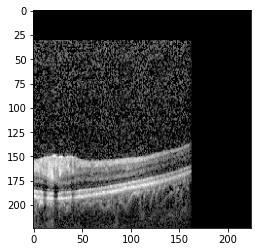

1/1 [==============================] - 0s 17ms/step
[[-2.5250242 -2.885323   3.9545603]]
Crop VKH , 395.46
CD7445 30-06-16 LE_000001_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000016_cropped.png


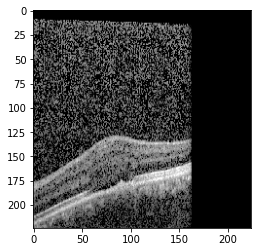

1/1 [==============================] - 0s 20ms/step
[[-2.5435846 -2.8888686  3.9663975]]
Crop VKH , 396.64
CD7445 30-06-16 LE_000016_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000009_cropped.png


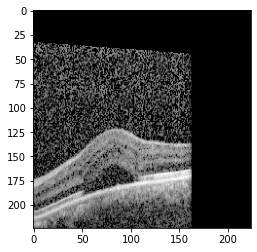

1/1 [==============================] - 0s 21ms/step
[[-2.5242627 -2.8889287  3.9602025]]
Crop VKH , 396.02
CD7445 30-06-16 LE_000009_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000004_cropped.png


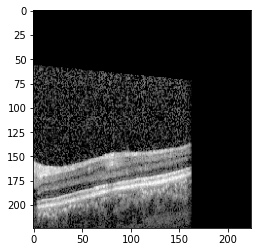

1/1 [==============================] - 0s 16ms/step
[[-2.5131848 -2.8851376  3.949623 ]]
Crop VKH , 394.96
CD7445 30-06-16 LE_000004_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000005_cropped.png


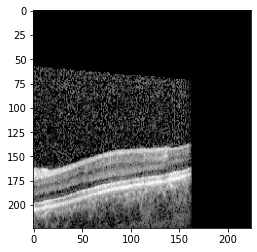

1/1 [==============================] - 0s 19ms/step
[[-2.5117614 -2.8860493  3.950087 ]]
Crop VKH , 395.01
CD7445 30-06-16 LE_000005_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000007_cropped.png


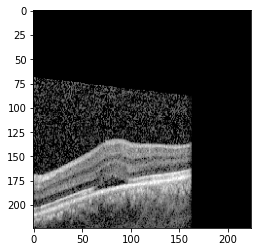

1/1 [==============================] - 0s 18ms/step
[[-2.5111434 -2.8854394  3.9468338]]
Crop VKH , 394.68
CD7445 30-06-16 LE_000007_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000019_cropped.png


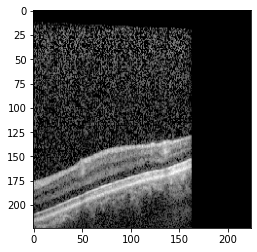

1/1 [==============================] - 0s 16ms/step
[[-2.5387456 -2.8770838  3.9531858]]
Crop VKH , 395.32
CD7445 30-06-16 LE_000019_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000008_cropped.png


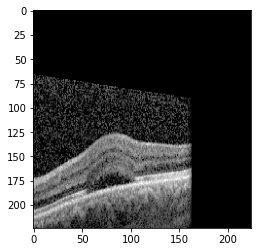

1/1 [==============================] - 0s 23ms/step
[[-2.5121217 -2.884914   3.9463294]]
Crop VKH , 394.63
CD7445 30-06-16 LE_000008_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000020_cropped.png


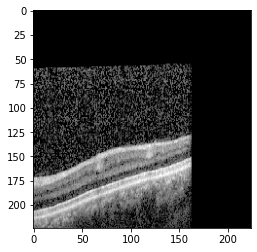

1/1 [==============================] - 0s 18ms/step
[[-2.519504  -2.879116   3.9482152]]
Crop VKH , 394.82
CD7445 30-06-16 LE_000020_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000018_cropped.png


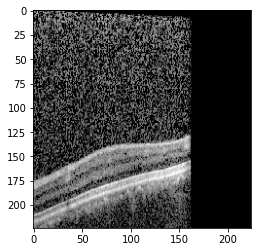

1/1 [==============================] - 0s 17ms/step
[[-2.5487986 -2.885691   3.9665327]]
Crop VKH , 396.65
CD7445 30-06-16 LE_000018_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000015_cropped.png


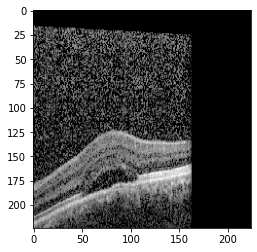

1/1 [==============================] - 0s 29ms/step
[[-2.5362716 -2.8873844  3.962042 ]]
Crop VKH , 396.20
CD7445 30-06-16 LE_000015_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000023_cropped.png


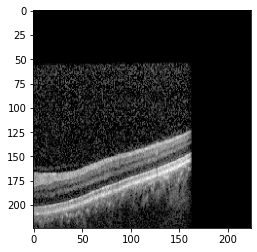

1/1 [==============================] - 0s 17ms/step
[[-2.5207958 -2.8772705  3.9443705]]
Crop VKH , 394.44
CD7445 30-06-16 LE_000023_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000002_cropped.png


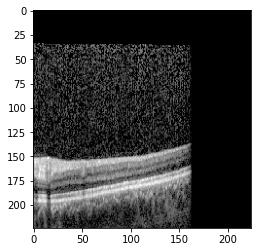

1/1 [==============================] - 0s 18ms/step
[[-2.5243027 -2.881421   3.95075  ]]
Crop VKH , 395.08
CD7445 30-06-16 LE_000002_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000014_cropped.png


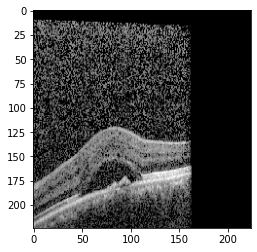

1/1 [==============================] - 0s 26ms/step
[[-2.543697  -2.8860893  3.9644165]]
Crop VKH , 396.44
CD7445 30-06-16 LE_000014_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000017_cropped.png


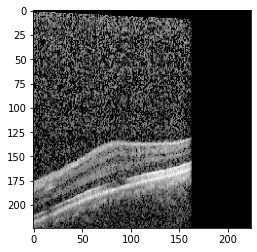

1/1 [==============================] - 0s 25ms/step
[[-2.5483234 -2.8870997  3.9680173]]
Crop VKH , 396.80
CD7445 30-06-16 LE_000017_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000013_cropped.png


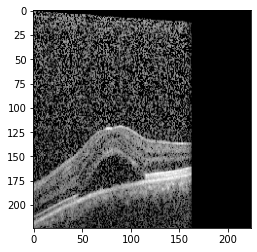

1/1 [==============================] - 0s 33ms/step
[[-2.5486126 -2.8896074  3.9698164]]
Crop VKH , 396.98
CD7445 30-06-16 LE_000013_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000010_cropped.png


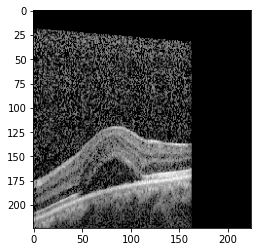

1/1 [==============================] - 0s 22ms/step
[[-2.5331407 -2.8859751  3.9601586]]
Crop VKH , 396.02
CD7445 30-06-16 LE_000010_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_001000_cropped.png


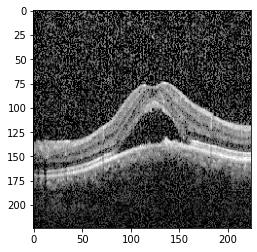

1/1 [==============================] - 0s 20ms/step
[[-2.57722   -2.878356   3.9741616]]
Crop VKH , 397.42
CD7445 30-06-16 LE_001000_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000011_cropped.png


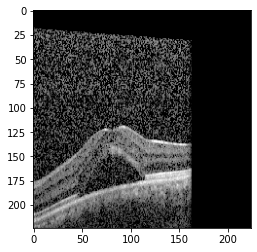

1/1 [==============================] - 0s 22ms/step
[[-2.530854  -2.8911486  3.9620435]]
Crop VKH , 396.20
CD7445 30-06-16 LE_000011_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000012_cropped.png


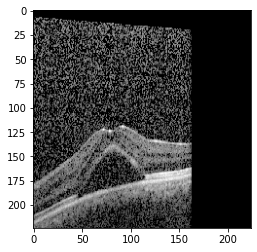

1/1 [==============================] - 0s 22ms/step
[[-2.5425591 -2.8884897  3.965793 ]]
Crop VKH , 396.58
CD7445 30-06-16 LE_000012_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_002_cropped.png


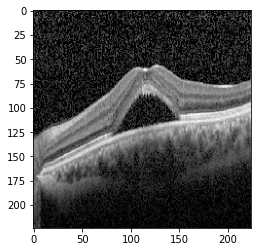

1/1 [==============================] - 0s 17ms/step
[[-2.5601013 -2.8551083  3.942281 ]]
Crop VKH , 394.23
CD7445 30-06-16 LE_002_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000021_cropped.png


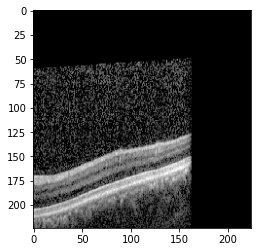

1/1 [==============================] - 0s 24ms/step
[[-2.5196905 -2.8830786  3.9492013]]
Crop VKH , 394.92
CD7445 30-06-16 LE_000021_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000022_cropped.png


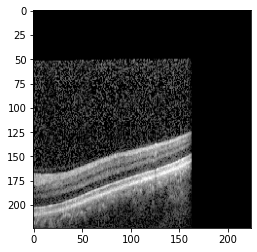

1/1 [==============================] - 0s 22ms/step
[[-2.5200095 -2.8800135  3.9472358]]
Crop VKH , 394.72
CD7445 30-06-16 LE_000022_cropped.png: Crop VKH
--------------------------------------------
CD7445 30-06-16 LE_000024_cropped.png


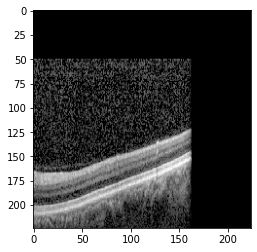

1/1 [==============================] - 0s 23ms/step
[[-2.5213962 -2.8763096  3.9448488]]
Crop VKH , 394.48
CD7445 30-06-16 LE_000024_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001008_cropped.png


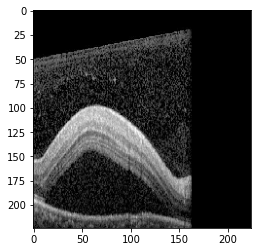

1/1 [==============================] - 0s 23ms/step
[[-2.5300586 -2.8645334  3.9364212]]
Crop VKH , 393.64
FN4102 01-26-17 RE_001008_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001005_cropped.png


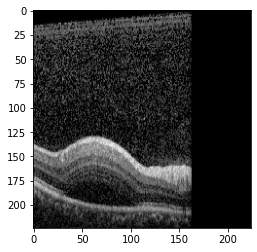

1/1 [==============================] - 0s 25ms/step
[[-2.5344486 -2.8714929  3.9447181]]
Crop VKH , 394.47
FN4102 01-26-17 RE_001005_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_000_cropped.png


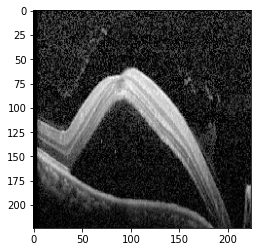

1/1 [==============================] - 0s 23ms/step
[[-2.5593202 -2.8591511  3.9441922]]
Crop VKH , 394.42
FN4102 01-26-17 RE_000_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001009_cropped.png


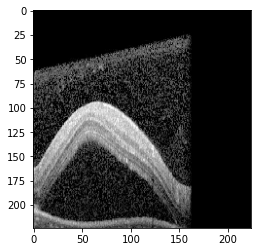

1/1 [==============================] - 0s 29ms/step
[[-2.5293524 -2.8661134  3.9378104]]
Crop VKH , 393.78
FN4102 01-26-17 RE_001009_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001006_cropped.png


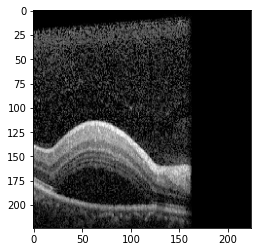

1/1 [==============================] - 0s 24ms/step
[[-2.5345523 -2.8677511  3.9410121]]
Crop VKH , 394.10
FN4102 01-26-17 RE_001006_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001002_cropped.png


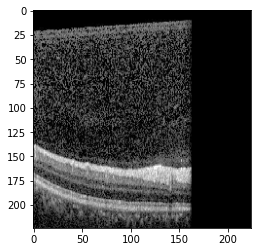

1/1 [==============================] - 0s 24ms/step
[[-2.5291636 -2.8811615  3.951449 ]]
Crop VKH , 395.14
FN4102 01-26-17 RE_001002_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001001_cropped.png


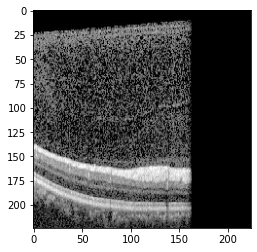

1/1 [==============================] - 0s 26ms/step
[[-2.5257905 -2.890192   3.9591048]]
Crop VKH , 395.91
FN4102 01-26-17 RE_001001_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001011_cropped.png


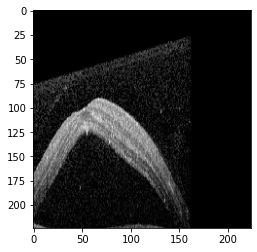

1/1 [==============================] - 0s 25ms/step
[[-2.525687  -2.8653464  3.933119 ]]
Crop VKH , 393.31
FN4102 01-26-17 RE_001011_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001003_cropped.png


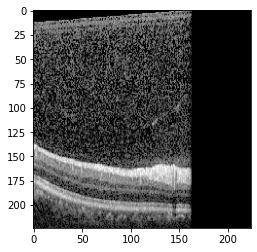

1/1 [==============================] - 0s 25ms/step
[[-2.5348017 -2.88384    3.956927 ]]
Crop VKH , 395.69
FN4102 01-26-17 RE_001003_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001000_cropped.png


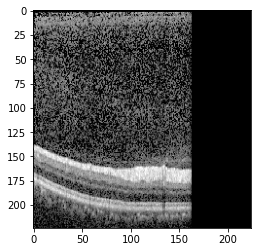

1/1 [==============================] - 0s 22ms/step
[[-2.5388515 -2.8873267  3.9631898]]
Crop VKH , 396.32
FN4102 01-26-17 RE_001000_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001010_cropped.png


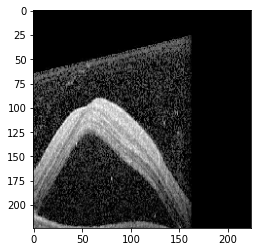

1/1 [==============================] - 0s 24ms/step
[[-2.5300994 -2.8689344  3.9400783]]
Crop VKH , 394.01
FN4102 01-26-17 RE_001010_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001012_cropped.png


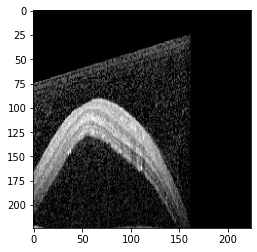

1/1 [==============================] - 0s 22ms/step
[[-2.5282562 -2.8678374  3.9368985]]
Crop VKH , 393.69
FN4102 01-26-17 RE_001012_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001007_cropped.png


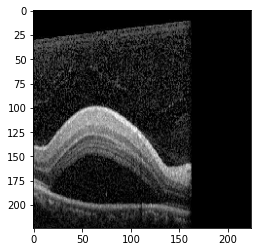

1/1 [==============================] - 0s 29ms/step
[[-2.5319762 -2.8633685  3.9350488]]
Crop VKH , 393.50
FN4102 01-26-17 RE_001007_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002003_cropped.png


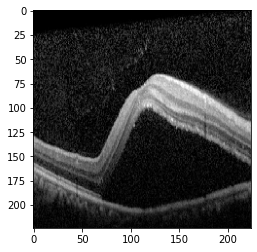

1/1 [==============================] - 0s 25ms/step
[[-2.5364938 -2.8622704  3.9342635]]
Crop VKH , 393.43
FN4102 01-26-17 RE_002003_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001019_cropped.png


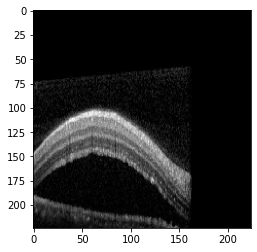

1/1 [==============================] - 0s 25ms/step
[[-2.5240152 -2.8606744  3.9272134]]
Crop VKH , 392.72
FN4102 01-26-17 RE_001019_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001015_cropped.png


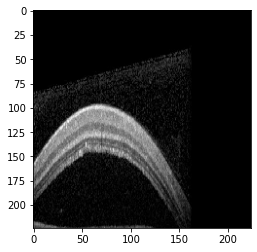

1/1 [==============================] - 0s 24ms/step
[[-2.5255015 -2.8594704  3.9273446]]
Crop VKH , 392.73
FN4102 01-26-17 RE_001015_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001004_cropped.png


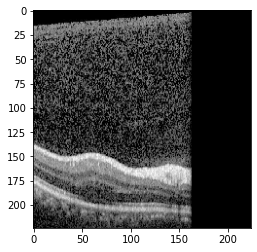

1/1 [==============================] - 0s 21ms/step
[[-2.5323808 -2.8833575  3.9561455]]
Crop VKH , 395.61
FN4102 01-26-17 RE_001004_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001017_cropped.png


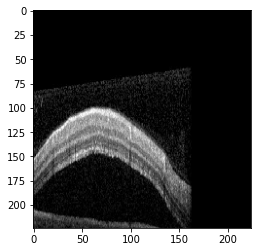

1/1 [==============================] - 0s 26ms/step
[[-2.522957  -2.8617127  3.9282224]]
Crop VKH , 392.82
FN4102 01-26-17 RE_001017_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001013_cropped.png


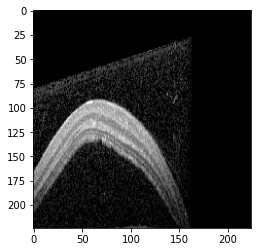

1/1 [==============================] - 0s 29ms/step
[[-2.526702  -2.8638728  3.9322767]]
Crop VKH , 393.23
FN4102 01-26-17 RE_001013_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002001_cropped.png


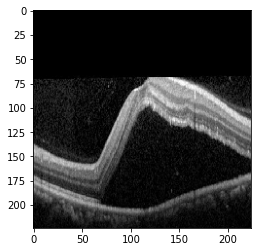

1/1 [==============================] - 0s 30ms/step
[[-2.5241377 -2.864708   3.9300697]]
Crop VKH , 393.01
FN4102 01-26-17 RE_002001_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001021_cropped.png


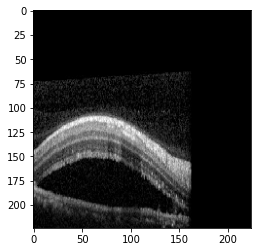

1/1 [==============================] - 0s 29ms/step
[[-2.5239832 -2.8618736  3.9287603]]
Crop VKH , 392.88
FN4102 01-26-17 RE_001021_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001020_cropped.png


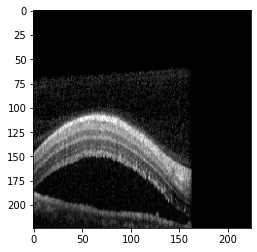

1/1 [==============================] - 0s 33ms/step
[[-2.524517  -2.8617074  3.9287095]]
Crop VKH , 392.87
FN4102 01-26-17 RE_001020_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001018_cropped.png


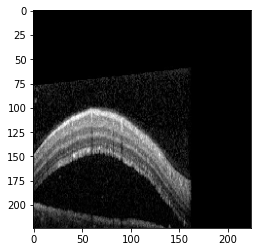

1/1 [==============================] - 0s 25ms/step
[[-2.5232275 -2.8623953  3.9287255]]
Crop VKH , 392.87
FN4102 01-26-17 RE_001018_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002002_cropped.png


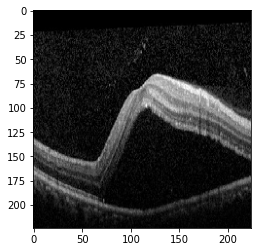

1/1 [==============================] - 0s 30ms/step
[[-2.5339684 -2.8624144  3.9334247]]
Crop VKH , 393.34
FN4102 01-26-17 RE_002002_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001024_cropped.png


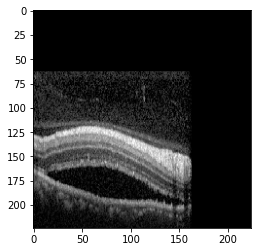

1/1 [==============================] - 0s 26ms/step
[[-2.5240366 -2.8642735  3.9315927]]
Crop VKH , 393.16
FN4102 01-26-17 RE_001024_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002000_cropped.png


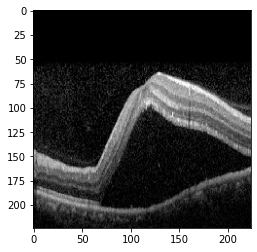

1/1 [==============================] - 0s 25ms/step
[[-2.5281453 -2.8670177  3.9349575]]
Crop VKH , 393.50
FN4102 01-26-17 RE_002000_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001022_cropped.png


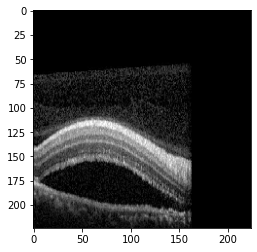

1/1 [==============================] - 0s 47ms/step
[[-2.5256763 -2.8614397  3.92975  ]]
Crop VKH , 392.97
FN4102 01-26-17 RE_001022_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001014_cropped.png


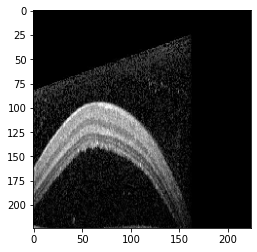

1/1 [==============================] - 0s 28ms/step
[[-2.5259693 -2.8643959  3.93237  ]]
Crop VKH , 393.24
FN4102 01-26-17 RE_001014_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001023_cropped.png


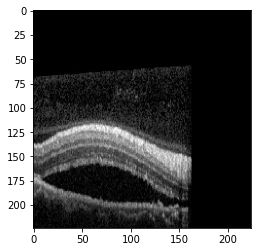

1/1 [==============================] - 0s 26ms/step
[[-2.5238993 -2.8649764  3.9317458]]
Crop VKH , 393.17
FN4102 01-26-17 RE_001023_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_001016_cropped.png


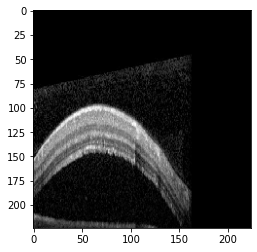

1/1 [==============================] - 0s 26ms/step
[[-2.5244844 -2.8599243  3.9274657]]
Crop VKH , 392.75
FN4102 01-26-17 RE_001016_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002005_cropped.png


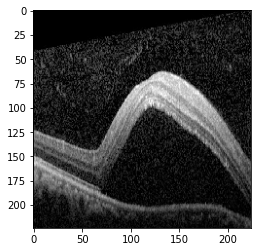

1/1 [==============================] - 0s 50ms/step
[[-2.5370977 -2.869205   3.9415882]]
Crop VKH , 394.16
FN4102 01-26-17 RE_002005_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002011_cropped.png


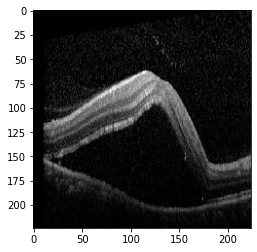

1/1 [==============================] - 0s 63ms/step
[[-2.534693  -2.8598566  3.9329345]]
Crop VKH , 393.29
FN4102 01-26-17 RE_002011_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002004_cropped.png


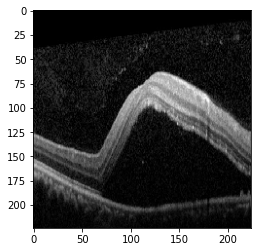

1/1 [==============================] - 0s 35ms/step
[[-2.532386  -2.860754   3.9314668]]
Crop VKH , 393.15
FN4102 01-26-17 RE_002004_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002006_cropped.png


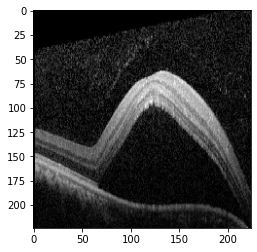

1/1 [==============================] - 0s 44ms/step
[[-2.536492  -2.8630762  3.9357703]]
Crop VKH , 393.58
FN4102 01-26-17 RE_002006_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002009_cropped.png


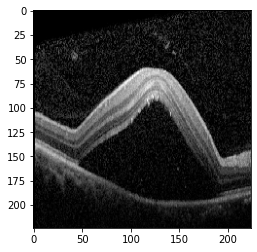

1/1 [==============================] - 0s 36ms/step
[[-2.5384986 -2.8641162  3.9381375]]
Crop VKH , 393.81
FN4102 01-26-17 RE_002009_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002010_cropped.png


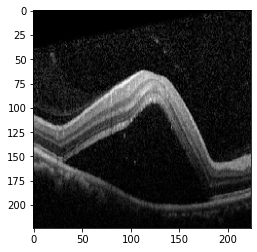

1/1 [==============================] - 0s 37ms/step
[[-2.5366645 -2.8598485  3.9338002]]
Crop VKH , 393.38
FN4102 01-26-17 RE_002010_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002007_cropped.png


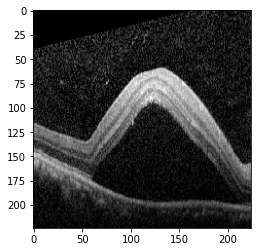

1/1 [==============================] - 0s 36ms/step
[[-2.5384088 -2.8661757  3.9392912]]
Crop VKH , 393.93
FN4102 01-26-17 RE_002007_cropped.png: Crop VKH
--------------------------------------------
FN4102 01-26-17 RE_002008_cropped.png


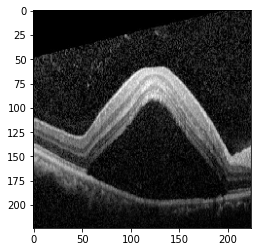

1/1 [==============================] - 0s 52ms/step
[[-2.536883  -2.8649921  3.937823 ]]
Crop VKH , 393.78
FN4102 01-26-17 RE_002008_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_000_cropped.png


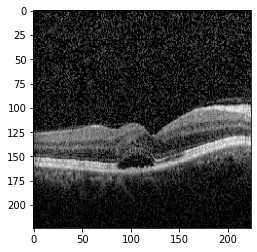

1/1 [==============================] - 0s 23ms/step
[[-2.5526097 -2.8758235  3.9576428]]
Crop VKH , 395.76
FF9561 19-10-17 RE_000_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001002_cropped.png


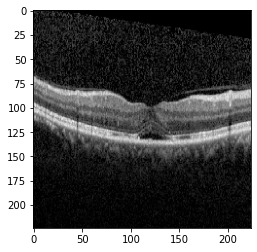

1/1 [==============================] - 0s 42ms/step
[[-2.539574  -2.8628602  3.937476 ]]
Crop VKH , 393.75
FF9561 19-10-17 RE_001002_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001008_cropped.png


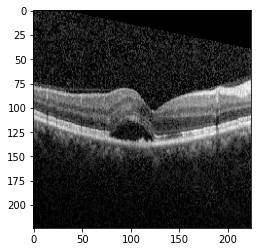

1/1 [==============================] - 0s 48ms/step
[[-2.539834  -2.8685822  3.9426472]]
Crop VKH , 394.26
FF9561 19-10-17 RE_001008_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001004_cropped.png


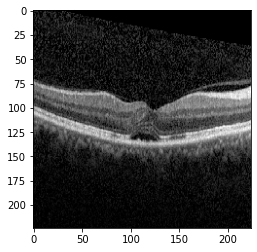

1/1 [==============================] - 0s 25ms/step
[[-2.53692   -2.865992   3.9387758]]
Crop VKH , 393.88
FF9561 19-10-17 RE_001004_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001006_cropped.png


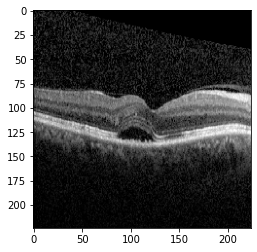

1/1 [==============================] - 0s 24ms/step
[[-2.5370796 -2.8668075  3.939581 ]]
Crop VKH , 393.96
FF9561 19-10-17 RE_001006_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001005_cropped.png


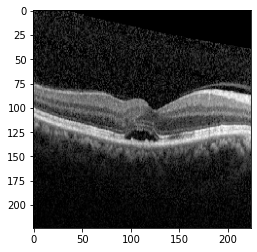

1/1 [==============================] - 0s 23ms/step
[[-2.5383027 -2.8648849  3.9385657]]
Crop VKH , 393.86
FF9561 19-10-17 RE_001005_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001009_cropped.png


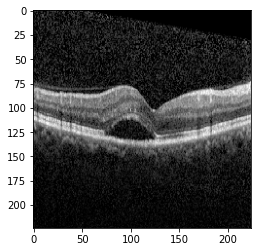

1/1 [==============================] - 0s 32ms/step
[[-2.542068 -2.867192  3.942624]]
Crop VKH , 394.26
FF9561 19-10-17 RE_001009_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001003_cropped.png


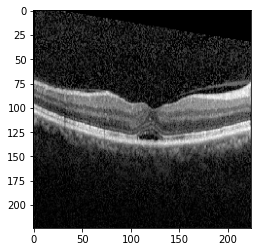

1/1 [==============================] - 0s 31ms/step
[[-2.5422328 -2.8629923  3.9387453]]
Crop VKH , 393.87
FF9561 19-10-17 RE_001003_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001001_cropped.png


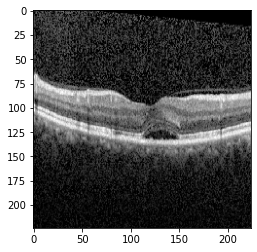

1/1 [==============================] - 0s 27ms/step
[[-2.5497084 -2.86423    3.9428694]]
Crop VKH , 394.29
FF9561 19-10-17 RE_001001_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002000_cropped.png


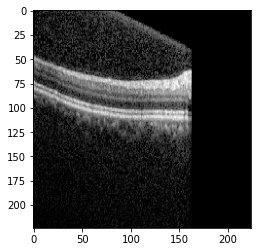

1/1 [==============================] - 0s 27ms/step
[[-2.5333955 -2.8651657  3.9347079]]
Crop VKH , 393.47
FF9561 19-10-17 RE_002000_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001007_cropped.png


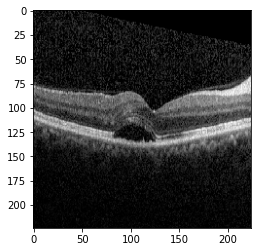

1/1 [==============================] - 0s 26ms/step
[[-2.5363142 -2.867782   3.9402306]]
Crop VKH , 394.02
FF9561 19-10-17 RE_001007_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002001_cropped.png


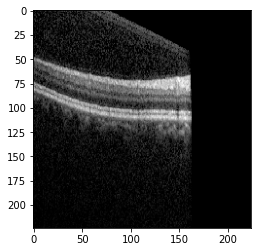

1/1 [==============================] - 0s 22ms/step
[[-2.531611  -2.863414   3.9331605]]
Crop VKH , 393.32
FF9561 19-10-17 RE_002001_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001010_cropped.png


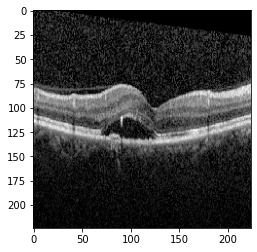

1/1 [==============================] - 0s 24ms/step
[[-2.5436199 -2.870089   3.9456713]]
Crop VKH , 394.57
FF9561 19-10-17 RE_001010_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001011_cropped.png


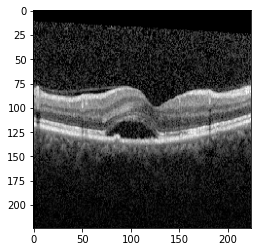

1/1 [==============================] - 0s 24ms/step
[[-2.5449436 -2.866374   3.9431179]]
Crop VKH , 394.31
FF9561 19-10-17 RE_001011_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_001000_cropped.png


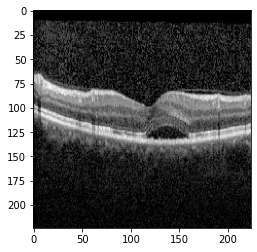

1/1 [==============================] - 0s 24ms/step
[[-2.5442576 -2.8638356  3.9398963]]
Crop VKH , 393.99
FF9561 19-10-17 RE_001000_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002008_cropped.png


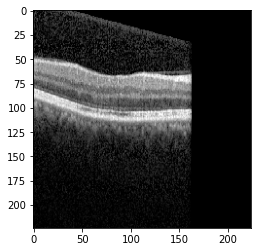

1/1 [==============================] - 0s 23ms/step
[[-2.531173  -2.8622758  3.929505 ]]
Crop VKH , 392.95
FF9561 19-10-17 RE_002008_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002013_cropped.png


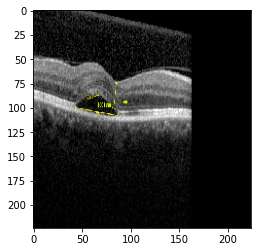

1/1 [==============================] - 0s 25ms/step
[[-2.525953  -2.8662758  3.932131 ]]
Crop VKH , 393.21
FF9561 19-10-17 RE_002013_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002009_cropped.png


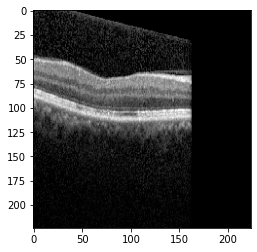

1/1 [==============================] - 0s 24ms/step
[[-2.5309088 -2.861631   3.9296348]]
Crop VKH , 392.96
FF9561 19-10-17 RE_002009_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002011_cropped.png


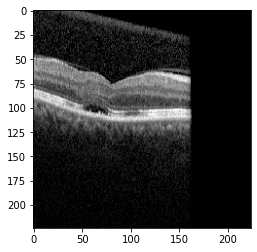

1/1 [==============================] - 0s 22ms/step
[[-2.5302463 -2.8620427  3.9299893]]
Crop VKH , 393.00
FF9561 19-10-17 RE_002011_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002005_cropped.png


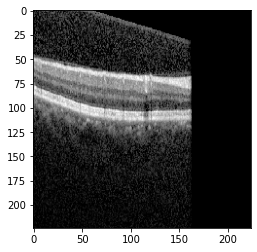

1/1 [==============================] - 0s 23ms/step
[[-2.5328882 -2.868513   3.9357622]]
Crop VKH , 393.58
FF9561 19-10-17 RE_002005_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002021_cropped.png


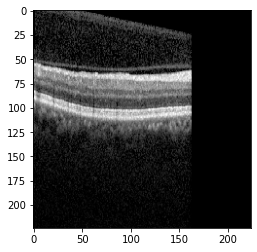

1/1 [==============================] - 0s 27ms/step
[[-2.5320227 -2.8611307  3.9301288]]
Crop VKH , 393.01
FF9561 19-10-17 RE_002021_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002012_cropped.png


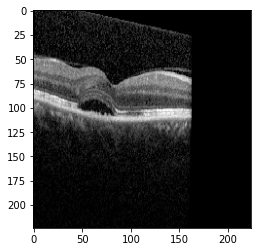

1/1 [==============================] - 0s 22ms/step
[[-2.5292604 -2.8635216  3.9311674]]
Crop VKH , 393.12
FF9561 19-10-17 RE_002012_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002015_cropped.png


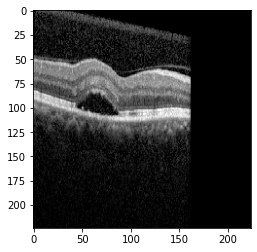

1/1 [==============================] - 0s 25ms/step
[[-2.5295792 -2.8635805  3.930848 ]]
Crop VKH , 393.08
FF9561 19-10-17 RE_002015_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002020_cropped.png


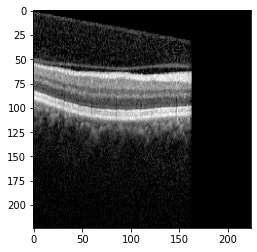

1/1 [==============================] - 0s 32ms/step
[[-2.531787  -2.8598948  3.9287665]]
Crop VKH , 392.88
FF9561 19-10-17 RE_002020_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002018_cropped.png


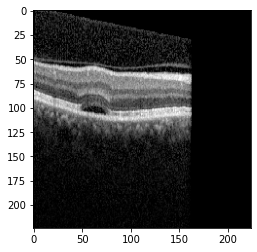

1/1 [==============================] - 0s 24ms/step
[[-2.5312402 -2.8619242  3.9303486]]
Crop VKH , 393.03
FF9561 19-10-17 RE_002018_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002006_cropped.png


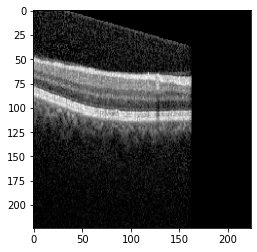

1/1 [==============================] - 0s 24ms/step
[[-2.5330598 -2.8610902  3.9303398]]
Crop VKH , 393.03
FF9561 19-10-17 RE_002006_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002002_cropped.png


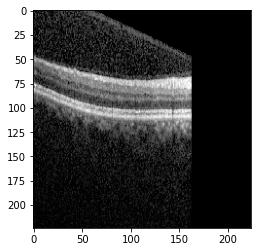

1/1 [==============================] - 0s 28ms/step
[[-2.5335805 -2.8642986  3.9336188]]
Crop VKH , 393.36
FF9561 19-10-17 RE_002002_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002007_cropped.png


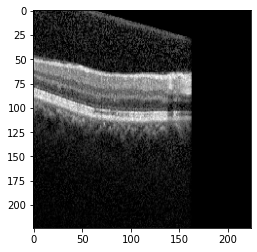

1/1 [==============================] - 0s 23ms/step
[[-2.5324366 -2.8640463  3.9322982]]
Crop VKH , 393.23
FF9561 19-10-17 RE_002007_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002019_cropped.png


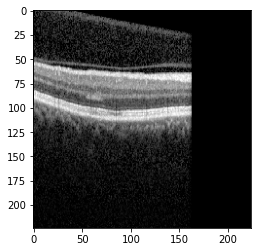

1/1 [==============================] - 0s 25ms/step
[[-2.5326583 -2.8620038  3.9303763]]
Crop VKH , 393.04
FF9561 19-10-17 RE_002019_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002004_cropped.png


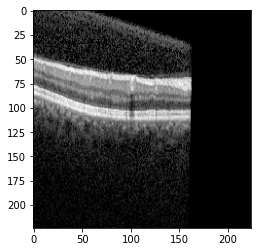

1/1 [==============================] - 0s 25ms/step
[[-2.5314376 -2.8647132  3.9314783]]
Crop VKH , 393.15
FF9561 19-10-17 RE_002004_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002003_cropped.png


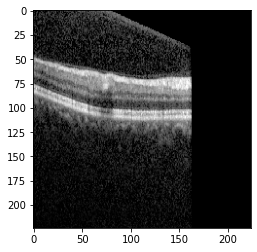

1/1 [==============================] - 0s 23ms/step
[[-2.5326774 -2.866034   3.9339845]]
Crop VKH , 393.40
FF9561 19-10-17 RE_002003_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002014_cropped.png


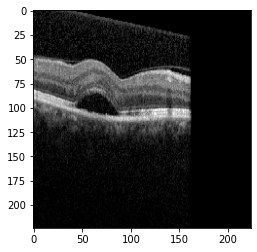

1/1 [==============================] - 0s 24ms/step
[[-2.528221  -2.8626034  3.9304612]]
Crop VKH , 393.05
FF9561 19-10-17 RE_002014_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002010_cropped.png


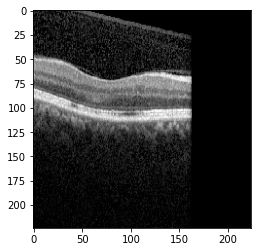

1/1 [==============================] - 0s 24ms/step
[[-2.5323503 -2.863056   3.9311173]]
Crop VKH , 393.11
FF9561 19-10-17 RE_002010_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002016_cropped.png


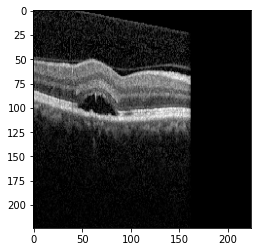

1/1 [==============================] - 0s 25ms/step
[[-2.530183 -2.862947  3.93167 ]]
Crop VKH , 393.17
FF9561 19-10-17 RE_002016_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002023_cropped.png


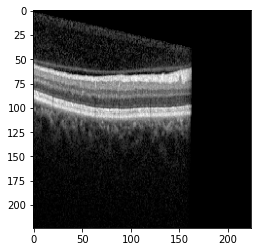

1/1 [==============================] - 0s 28ms/step
[[-2.5287762 -2.860046   3.9274116]]
Crop VKH , 392.74
FF9561 19-10-17 RE_002023_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002017_cropped.png


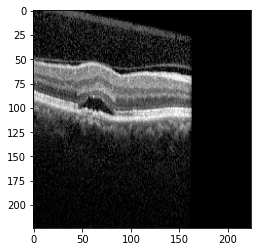

1/1 [==============================] - 0s 24ms/step
[[-2.5308568 -2.8630252  3.9309537]]
Crop VKH , 393.10
FF9561 19-10-17 RE_002017_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002024_cropped.png


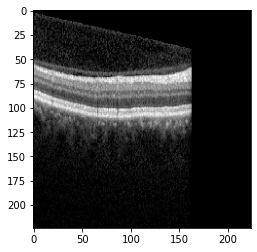

1/1 [==============================] - 0s 22ms/step
[[-2.5293863 -2.8601322  3.9276607]]
Crop VKH , 392.77
FF9561 19-10-17 RE_002024_cropped.png: Crop VKH
--------------------------------------------
FF9561 19-10-17 RE_002022_cropped.png


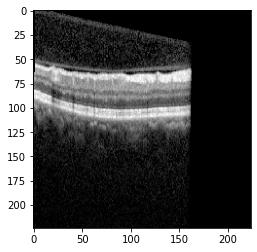

1/1 [==============================] - 0s 35ms/step
[[-2.531212  -2.8602014  3.9278047]]
Crop VKH , 392.78
FF9561 19-10-17 RE_002022_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001004_cropped.png


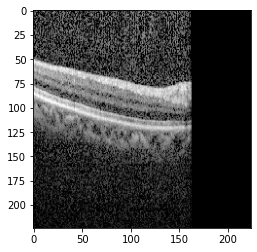

1/1 [==============================] - 0s 29ms/step
[[-2.546982  -2.8730564  3.946089 ]]
Crop VKH , 394.61
EV7009 23-11-17 RE_001004_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001014_cropped.png


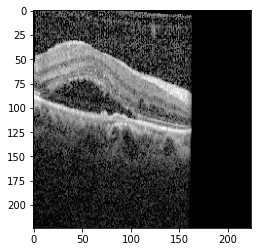

1/1 [==============================] - 0s 26ms/step
[[-2.5446823 -2.8726313  3.9435806]]
Crop VKH , 394.36
EV7009 23-11-17 RE_001014_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_000_cropped.png


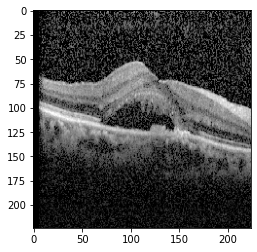

1/1 [==============================] - 0s 26ms/step
[[-2.5708477 -2.8692098  3.9565687]]
Crop VKH , 395.66
EV7009 23-11-17 RE_000_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001000_cropped.png


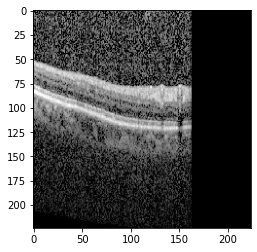

1/1 [==============================] - 0s 27ms/step
[[-2.54725   -2.8748393  3.948347 ]]
Crop VKH , 394.83
EV7009 23-11-17 RE_001000_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001010_cropped.png


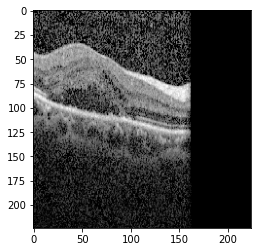

1/1 [==============================] - 0s 24ms/step
[[-2.5445025 -2.8757753  3.9469187]]
Crop VKH , 394.69
EV7009 23-11-17 RE_001010_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001008_cropped.png


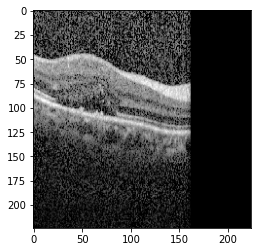

1/1 [==============================] - 0s 24ms/step
[[-2.544449  -2.8757198  3.9473515]]
Crop VKH , 394.74
EV7009 23-11-17 RE_001008_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001002_cropped.png


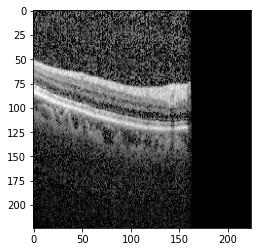

1/1 [==============================] - 0s 23ms/step
[[-2.5452108 -2.875855   3.947733 ]]
Crop VKH , 394.77
EV7009 23-11-17 RE_001002_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001006_cropped.png


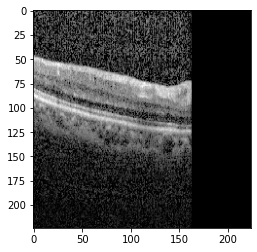

1/1 [==============================] - 0s 24ms/step
[[-2.5442207 -2.870468   3.9420254]]
Crop VKH , 394.20
EV7009 23-11-17 RE_001006_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001007_cropped.png


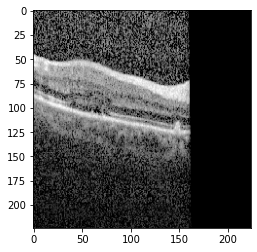

1/1 [==============================] - 0s 34ms/step
[[-2.5453937 -2.878271   3.9484587]]
Crop VKH , 394.85
EV7009 23-11-17 RE_001007_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001001_cropped.png


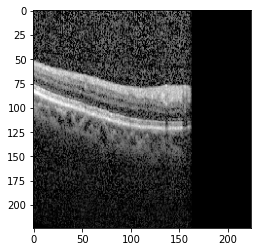

1/1 [==============================] - 0s 24ms/step
[[-2.5443647 -2.8728147  3.9451087]]
Crop VKH , 394.51
EV7009 23-11-17 RE_001001_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001003_cropped.png


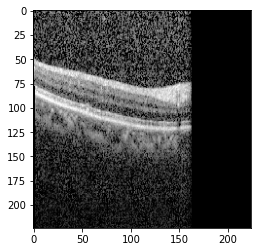

1/1 [==============================] - 0s 22ms/step
[[-2.5468566 -2.874339   3.9472866]]
Crop VKH , 394.73
EV7009 23-11-17 RE_001003_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001015_cropped.png


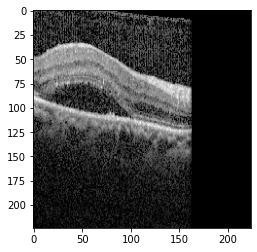

1/1 [==============================] - 0s 22ms/step
[[-2.5375924 -2.8750675  3.943425 ]]
Crop VKH , 394.34
EV7009 23-11-17 RE_001015_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001005_cropped.png


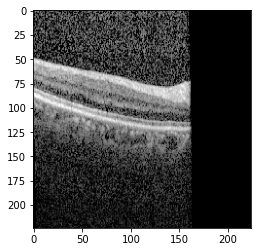

1/1 [==============================] - 0s 23ms/step
[[-2.5451849 -2.874199   3.9458778]]
Crop VKH , 394.59
EV7009 23-11-17 RE_001005_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001009_cropped.png


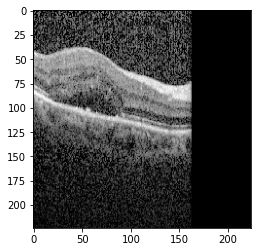

1/1 [==============================] - 0s 22ms/step
[[-2.5429435 -2.8788807  3.9478233]]
Crop VKH , 394.78
EV7009 23-11-17 RE_001009_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002003_cropped.png


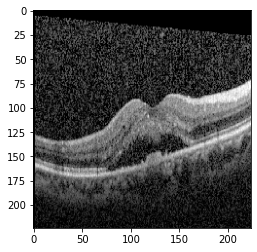

1/1 [==============================] - 0s 29ms/step
[[-2.5490353 -2.8651462  3.945945 ]]
Crop VKH , 394.59
EV7009 23-11-17 RE_002003_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001017_cropped.png


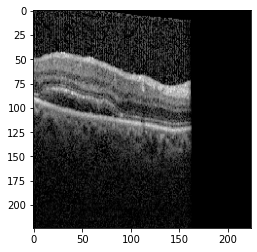

1/1 [==============================] - 0s 24ms/step
[[-2.5386539 -2.8671522  3.9384727]]
Crop VKH , 393.85
EV7009 23-11-17 RE_001017_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001013_cropped.png


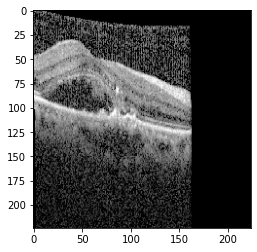

1/1 [==============================] - 0s 23ms/step
[[-2.5460565 -2.8727047  3.9444492]]
Crop VKH , 394.44
EV7009 23-11-17 RE_001013_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001020_cropped.png


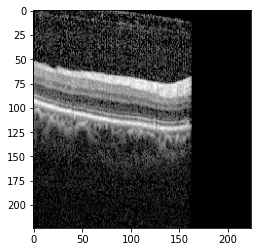

1/1 [==============================] - 0s 24ms/step
[[-2.5431564 -2.868098   3.9392743]]
Crop VKH , 393.93
EV7009 23-11-17 RE_001020_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001012_cropped.png


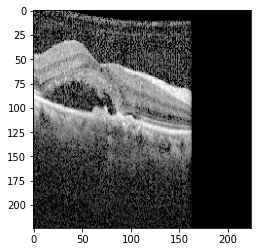

1/1 [==============================] - 0s 23ms/step
[[-2.5493617 -2.871497   3.9441173]]
Crop VKH , 394.41
EV7009 23-11-17 RE_001012_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001021_cropped.png


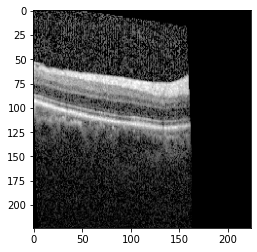

1/1 [==============================] - 0s 24ms/step
[[-2.5428667 -2.8720868  3.9426997]]
Crop VKH , 394.27
EV7009 23-11-17 RE_001021_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001018_cropped.png


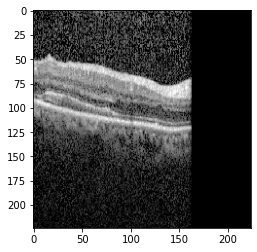

1/1 [==============================] - 0s 26ms/step
[[-2.5435855 -2.8705454  3.9413388]]
Crop VKH , 394.13
EV7009 23-11-17 RE_001018_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002002_cropped.png


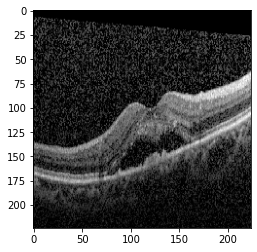

1/1 [==============================] - 0s 24ms/step
[[-2.545174  -2.8695197  3.9473796]]
Crop VKH , 394.74
EV7009 23-11-17 RE_002002_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002000_cropped.png


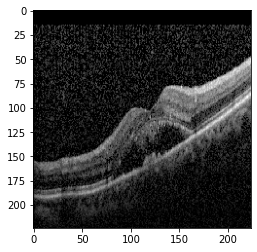

1/1 [==============================] - 0s 25ms/step
[[-2.5417638 -2.8749723  3.949841 ]]
Crop VKH , 394.98
EV7009 23-11-17 RE_002000_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002001_cropped.png


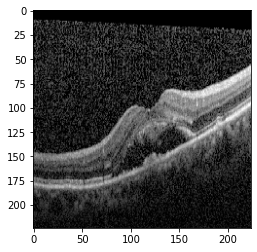

1/1 [==============================] - 0s 23ms/step
[[-2.5451071 -2.866136   3.9437683]]
Crop VKH , 394.38
EV7009 23-11-17 RE_002001_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001019_cropped.png


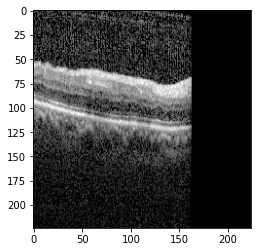

1/1 [==============================] - 0s 23ms/step
[[-2.542896  -2.8706005  3.9419272]]
Crop VKH , 394.19
EV7009 23-11-17 RE_001019_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001023_cropped.png


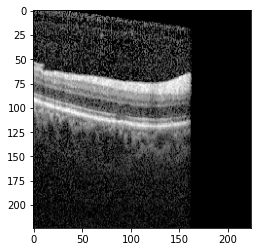

1/1 [==============================] - 0s 28ms/step
[[-2.5447454 -2.8667874  3.9393668]]
Crop VKH , 393.94
EV7009 23-11-17 RE_001023_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001016_cropped.png


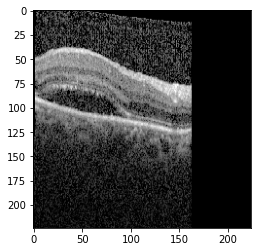

1/1 [==============================] - 0s 23ms/step
[[-2.541355  -2.8730836  3.9433787]]
Crop VKH , 394.34
EV7009 23-11-17 RE_001016_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001022_cropped.png


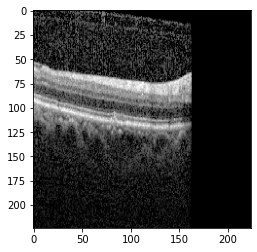

1/1 [==============================] - 0s 24ms/step
[[-2.54091   -2.8697324  3.9404025]]
Crop VKH , 394.04
EV7009 23-11-17 RE_001022_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001011_cropped.png


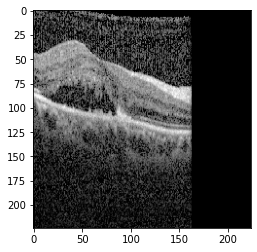

1/1 [==============================] - 0s 24ms/step
[[-2.5448573 -2.8713994  3.9438002]]
Crop VKH , 394.38
EV7009 23-11-17 RE_001011_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002007_cropped.png


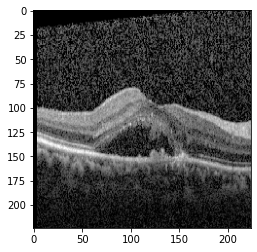

1/1 [==============================] - 0s 25ms/step
[[-2.55502   -2.8603969  3.9458687]]
Crop VKH , 394.59
EV7009 23-11-17 RE_002007_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002008_cropped.png


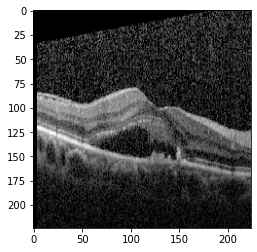

1/1 [==============================] - 0s 22ms/step
[[-2.5468338 -2.8651814  3.9448762]]
Crop VKH , 394.49
EV7009 23-11-17 RE_002008_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002009_cropped.png


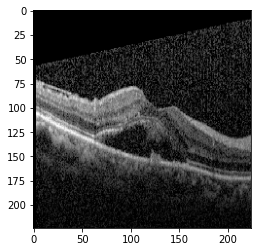

1/1 [==============================] - 0s 23ms/step
[[-2.5381515 -2.8697724  3.9443102]]
Crop VKH , 394.43
EV7009 23-11-17 RE_002009_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002010_cropped.png


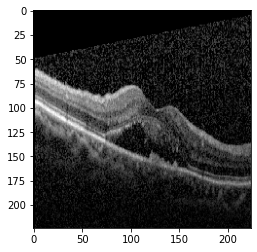

1/1 [==============================] - 0s 24ms/step
[[-2.5371854 -2.8721957  3.945143 ]]
Crop VKH , 394.51
EV7009 23-11-17 RE_002010_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002006_cropped.png


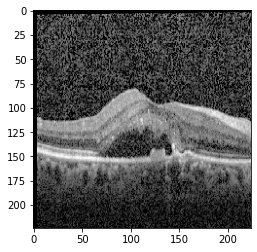

1/1 [==============================] - 0s 23ms/step
[[-2.5680208 -2.8531241  3.94669  ]]
Crop VKH , 394.67
EV7009 23-11-17 RE_002006_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002005_cropped.png


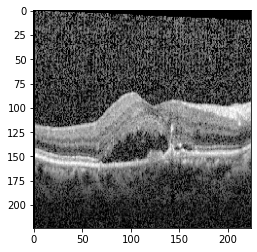

1/1 [==============================] - 0s 24ms/step
[[-2.5687413 -2.8570232  3.9504354]]
Crop VKH , 395.04
EV7009 23-11-17 RE_002005_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002011_cropped.png


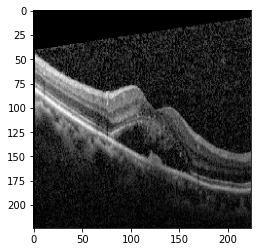

1/1 [==============================] - 0s 24ms/step
[[-2.5371263 -2.868597   3.9415345]]
Crop VKH , 394.15
EV7009 23-11-17 RE_002011_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_002004_cropped.png


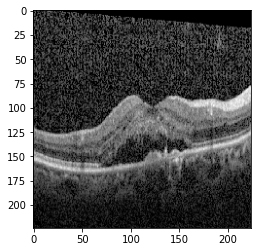

1/1 [==============================] - 0s 23ms/step
[[-2.5536854 -2.8616157  3.945548 ]]
Crop VKH , 394.55
EV7009 23-11-17 RE_002004_cropped.png: Crop VKH
--------------------------------------------
EV7009 23-11-17 RE_001024_cropped.png


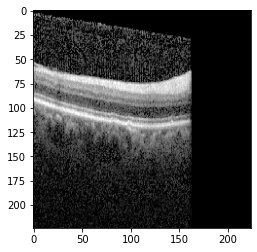

1/1 [==============================] - 0s 30ms/step
[[-2.5424335 -2.8645518  3.9361556]]
Crop VKH , 393.62
EV7009 23-11-17 RE_001024_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001000_cropped.png


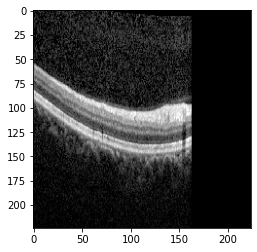

1/1 [==============================] - 0s 22ms/step
[[-2.5356164 -2.8609128  3.9326854]]
Crop VKH , 393.27
DW7241 20-06-17 RE_001000_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001009_cropped.png


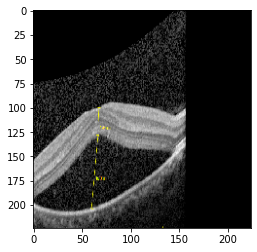

1/1 [==============================] - 0s 23ms/step
[[-2.5277598 -2.8669336  3.9339995]]
Crop VKH , 393.40
DW7241 20-06-17 RE_001009_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001004_cropped.png


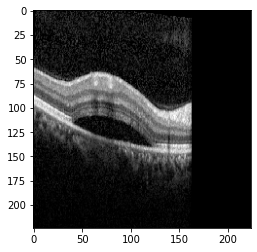

1/1 [==============================] - 0s 22ms/step
[[-2.53126   -2.86258    3.9319513]]
Crop VKH , 393.20
DW7241 20-06-17 RE_001004_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001002_cropped.png


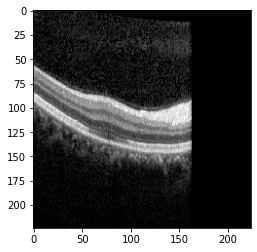

1/1 [==============================] - 0s 24ms/step
[[-2.5324166 -2.8587031  3.929023 ]]
Crop VKH , 392.90
DW7241 20-06-17 RE_001002_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001003_cropped.png


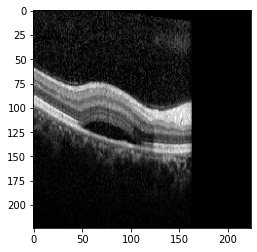

1/1 [==============================] - 0s 22ms/step
[[-2.5303657 -2.8624206  3.930908 ]]
Crop VKH , 393.09
DW7241 20-06-17 RE_001003_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001005_cropped.png


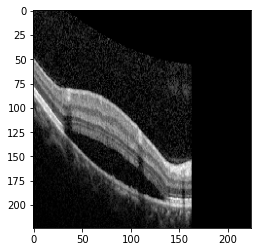

1/1 [==============================] - 0s 25ms/step
[[-2.5288775 -2.866221   3.9342842]]
Crop VKH , 393.43
DW7241 20-06-17 RE_001005_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001011_cropped.png


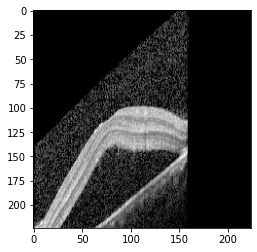

1/1 [==============================] - 0s 23ms/step
[[-2.5251112 -2.8728526  3.9383295]]
Crop VKH , 393.83
DW7241 20-06-17 RE_001011_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001007_cropped.png


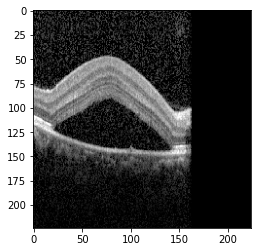

1/1 [==============================] - 0s 25ms/step
[[-2.536115  -2.8721876  3.9416916]]
Crop VKH , 394.17
DW7241 20-06-17 RE_001007_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001013_cropped.png


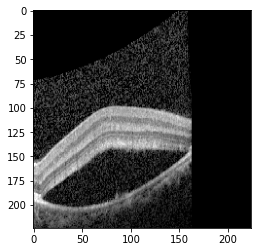

1/1 [==============================] - 0s 24ms/step
[[-2.5320454 -2.8614867  3.9337656]]
Crop VKH , 393.38
DW7241 20-06-17 RE_001013_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_000_cropped.png


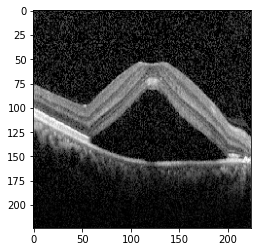

1/1 [==============================] - 0s 27ms/step
[[-2.548909  -2.8719022  3.9492714]]
Crop VKH , 394.93
DW7241 20-06-17 RE_000_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001010_cropped.png


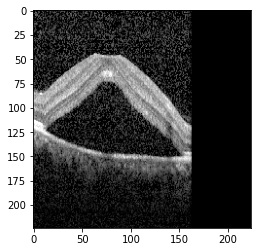

1/1 [==============================] - 0s 25ms/step
[[-2.537268  -2.8798847  3.9494655]]
Crop VKH , 394.95
DW7241 20-06-17 RE_001010_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001008_cropped.png


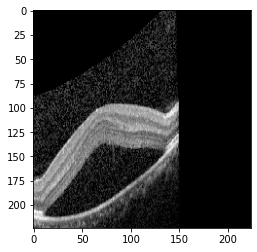

1/1 [==============================] - 0s 26ms/step
[[-2.525357  -2.865972   3.9338603]]
Crop VKH , 393.39
DW7241 20-06-17 RE_001008_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001006_cropped.png


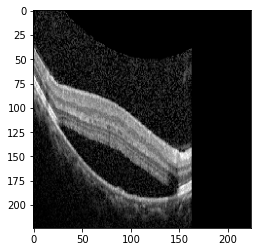

1/1 [==============================] - 0s 33ms/step
[[-2.529965  -2.8665352  3.9349859]]
Crop VKH , 393.50
DW7241 20-06-17 RE_001006_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001012_cropped.png


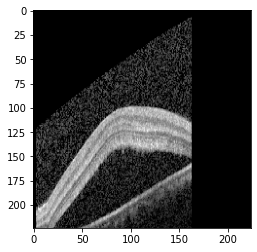

1/1 [==============================] - 0s 23ms/step
[[-2.5250285 -2.8704815  3.9371924]]
Crop VKH , 393.72
DW7241 20-06-17 RE_001012_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001001_cropped.png


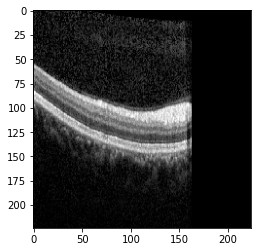

1/1 [==============================] - 0s 25ms/step
[[-2.5330217 -2.859045   3.9302065]]
Crop VKH , 393.02
DW7241 20-06-17 RE_001001_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001015_cropped.png


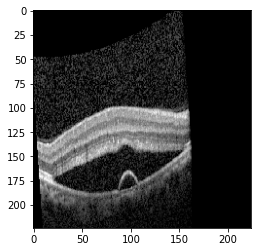

1/1 [==============================] - 0s 24ms/step
[[-2.5311744 -2.8607078  3.9327807]]
Crop VKH , 393.28
DW7241 20-06-17 RE_001015_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001022_cropped.png


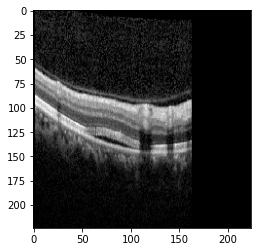

1/1 [==============================] - 0s 22ms/step
[[-2.5316727 -2.861129   3.9309576]]
Crop VKH , 393.10
DW7241 20-06-17 RE_001022_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002000_cropped.png


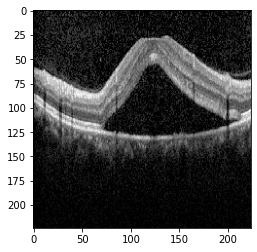

1/1 [==============================] - 0s 23ms/step
[[-2.5421786 -2.8663387  3.94216  ]]
Crop VKH , 394.22
DW7241 20-06-17 RE_002000_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001017_cropped.png


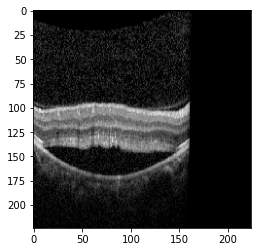

1/1 [==============================] - 0s 23ms/step
[[-2.532285  -2.8599195  3.930785 ]]
Crop VKH , 393.08
DW7241 20-06-17 RE_001017_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002001_cropped.png


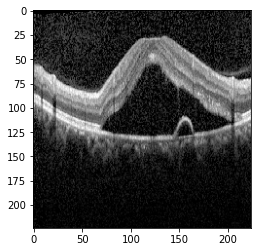

1/1 [==============================] - 0s 22ms/step
[[-2.5415902 -2.8654733  3.940945 ]]
Crop VKH , 394.09
DW7241 20-06-17 RE_002001_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001016_cropped.png


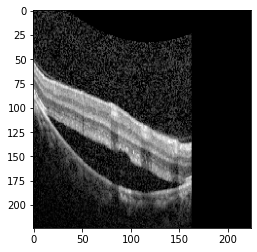

1/1 [==============================] - 0s 23ms/step
[[-2.5360405 -2.8666775  3.938152 ]]
Crop VKH , 393.82
DW7241 20-06-17 RE_001016_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001020_cropped.png


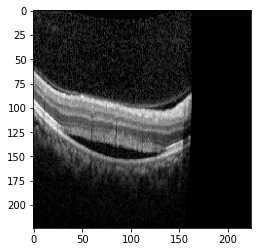

1/1 [==============================] - 0s 24ms/step
[[-2.5331986 -2.8597937  3.9307072]]
Crop VKH , 393.07
DW7241 20-06-17 RE_001020_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001019_cropped.png


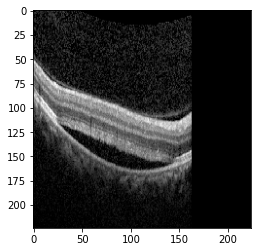

1/1 [==============================] - 0s 39ms/step
[[-2.5355897 -2.8611054  3.9330113]]
Crop VKH , 393.30
DW7241 20-06-17 RE_001019_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001014_cropped.png


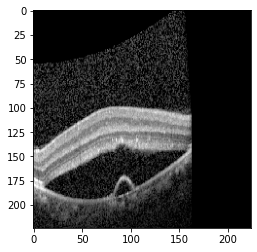

1/1 [==============================] - 0s 26ms/step
[[-2.533597 -2.860355  3.933563]]
Crop VKH , 393.36
DW7241 20-06-17 RE_001014_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001023_cropped.png


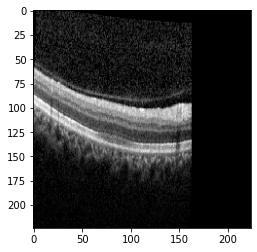

1/1 [==============================] - 0s 23ms/step
[[-2.5308888 -2.8622046  3.9315593]]
Crop VKH , 393.16
DW7241 20-06-17 RE_001023_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001018_cropped.png


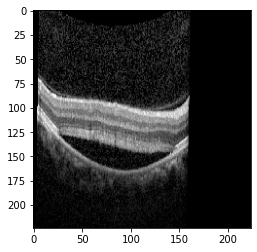

1/1 [==============================] - 0s 26ms/step
[[-2.535546  -2.8590298  3.9315119]]
Crop VKH , 393.15
DW7241 20-06-17 RE_001018_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001021_cropped.png


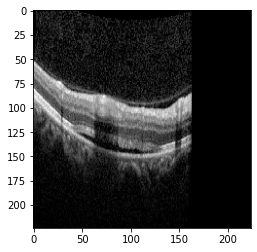

1/1 [==============================] - 0s 22ms/step
[[-2.5310376 -2.8632126  3.932364 ]]
Crop VKH , 393.24
DW7241 20-06-17 RE_001021_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_001024_cropped.png


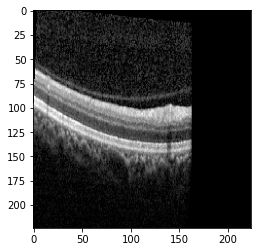

1/1 [==============================] - 0s 25ms/step
[[-2.5312424 -2.8637512  3.9327574]]
Crop VKH , 393.28
DW7241 20-06-17 RE_001024_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002005_cropped.png


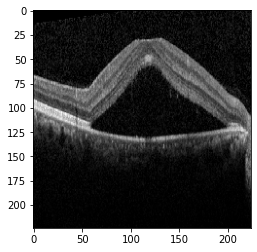

1/1 [==============================] - 0s 25ms/step
[[-2.5335937 -2.8609626  3.9331706]]
Crop VKH , 393.32
DW7241 20-06-17 RE_002005_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002006_cropped.png


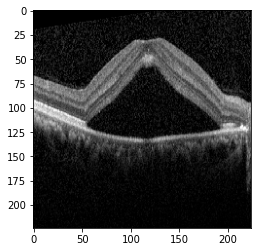

1/1 [==============================] - 0s 23ms/step
[[-2.533774  -2.8652272  3.9364705]]
Crop VKH , 393.65
DW7241 20-06-17 RE_002006_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002002_cropped.png


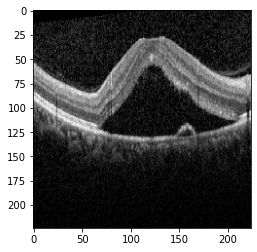

1/1 [==============================] - 0s 25ms/step
[[-2.5364234 -2.8641076  3.9370604]]
Crop VKH , 393.71
DW7241 20-06-17 RE_002002_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000005_cropped.png


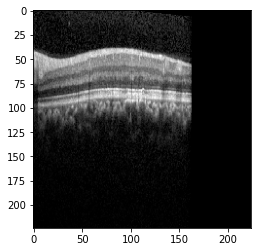

1/1 [==============================] - 0s 27ms/step
[[-2.5280576 -2.8603668  3.9275997]]
Crop VKH , 392.76
FM9706 15-07-16 LE_000005_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000000_cropped.png


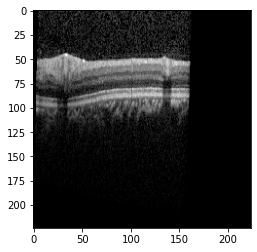

1/1 [==============================] - 0s 27ms/step
[[-2.5315907 -2.8603196  3.9305499]]
Crop VKH , 393.05
FM9706 15-07-16 LE_000000_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000003_cropped.png


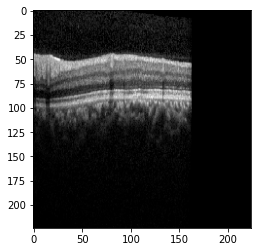

1/1 [==============================] - 0s 24ms/step
[[-2.5291915 -2.8577523  3.9268167]]
Crop VKH , 392.68
FM9706 15-07-16 LE_000003_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002011_cropped.png


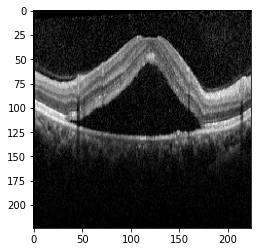

1/1 [==============================] - 0s 25ms/step
[[-2.5347667 -2.864386   3.9361017]]
Crop VKH , 393.61
DW7241 20-06-17 RE_002011_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002010_cropped.png


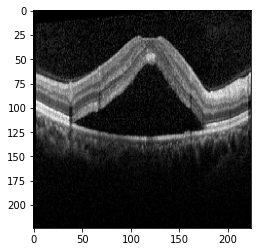

1/1 [==============================] - 0s 23ms/step
[[-2.5322134 -2.862628   3.93319  ]]
Crop VKH , 393.32
DW7241 20-06-17 RE_002010_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002008_cropped.png


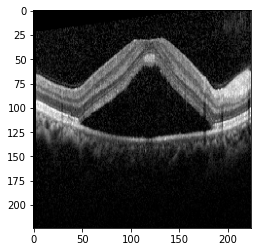

1/1 [==============================] - 0s 23ms/step
[[-2.532682  -2.8649516  3.9357646]]
Crop VKH , 393.58
DW7241 20-06-17 RE_002008_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000008_cropped.png


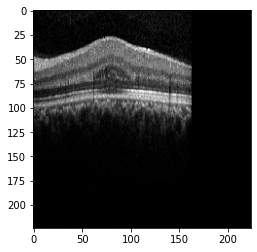

1/1 [==============================] - 0s 26ms/step
[[-2.5296237 -2.8553386  3.9263213]]
Crop VKH , 392.63
FM9706 15-07-16 LE_000008_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000002_cropped.png


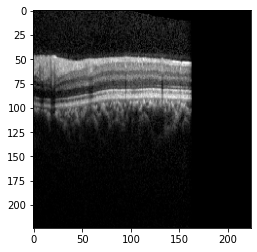

1/1 [==============================] - 0s 24ms/step
[[-2.5290134 -2.8585567  3.9274232]]
Crop VKH , 392.74
FM9706 15-07-16 LE_000002_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000007_cropped.png


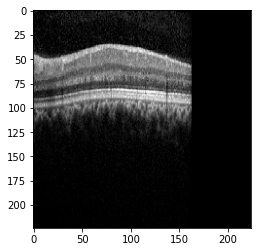

1/1 [==============================] - 0s 23ms/step
[[-2.5293207 -2.8575492  3.926884 ]]
Crop VKH , 392.69
FM9706 15-07-16 LE_000007_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000006_cropped.png


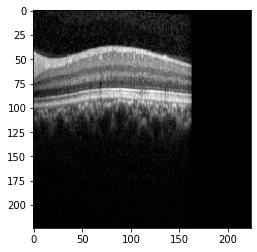

1/1 [==============================] - 0s 22ms/step
[[-2.5283232 -2.8595757  3.927334 ]]
Crop VKH , 392.73
FM9706 15-07-16 LE_000006_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000001_cropped.png


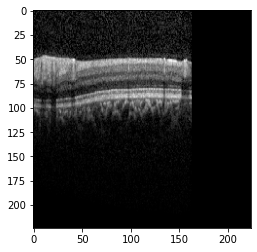

1/1 [==============================] - 0s 24ms/step
[[-2.5311801 -2.8593924  3.9296978]]
Crop VKH , 392.97
FM9706 15-07-16 LE_000001_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002003_cropped.png


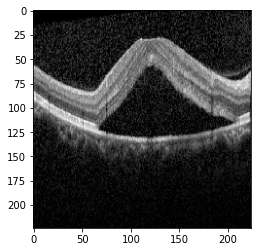

1/1 [==============================] - 0s 23ms/step
[[-2.53806   -2.8653102  3.9390676]]
Crop VKH , 393.91
DW7241 20-06-17 RE_002003_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000004_cropped.png


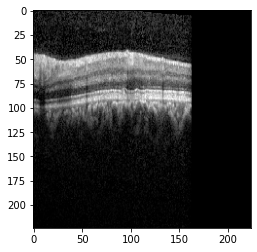

1/1 [==============================] - 0s 23ms/step
[[-2.5288978 -2.8623428  3.9297378]]
Crop VKH , 392.97
FM9706 15-07-16 LE_000004_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002004_cropped.png


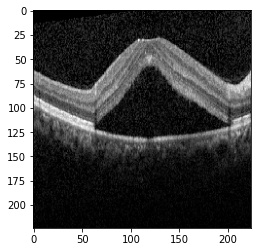

1/1 [==============================] - 0s 24ms/step
[[-2.5369103 -2.8642328  3.9373562]]
Crop VKH , 393.74
DW7241 20-06-17 RE_002004_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002009_cropped.png


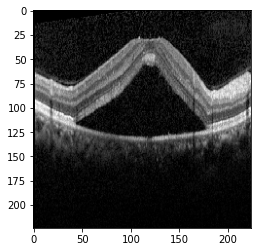

1/1 [==============================] - 0s 26ms/step
[[-2.534764  -2.862239   3.9342334]]
Crop VKH , 393.42
DW7241 20-06-17 RE_002009_cropped.png: Crop VKH
--------------------------------------------
DW7241 20-06-17 RE_002007_cropped.png


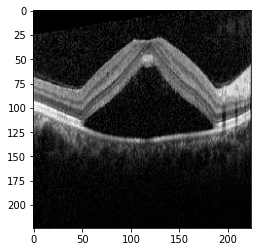

1/1 [==============================] - 0s 22ms/step
[[-2.5313106 -2.8654463  3.9351285]]
Crop VKH , 393.51
DW7241 20-06-17 RE_002007_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000014_cropped.png


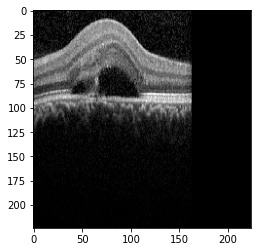

1/1 [==============================] - 0s 29ms/step
[[-2.5294235 -2.8607926  3.9298503]]
Crop VKH , 392.99
FM9706 15-07-16 LE_000014_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000019_cropped.png


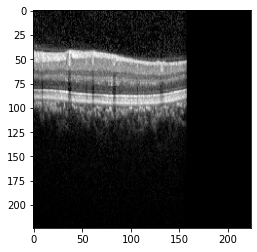

1/1 [==============================] - 0s 23ms/step
[[-2.5293384 -2.8613505  3.929307 ]]
Crop VKH , 392.93
FM9706 15-07-16 LE_000019_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000020_cropped.png


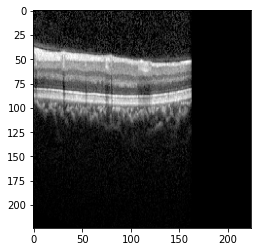

1/1 [==============================] - 0s 24ms/step
[[-2.5297968 -2.863171   3.930401 ]]
Crop VKH , 393.04
FM9706 15-07-16 LE_000020_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001002_cropped.png


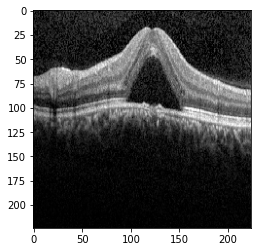

1/1 [==============================] - 0s 23ms/step
[[-2.5360155 -2.8613112  3.9341385]]
Crop VKH , 393.41
FM9706 15-07-16 LE_001002_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000012_cropped.png


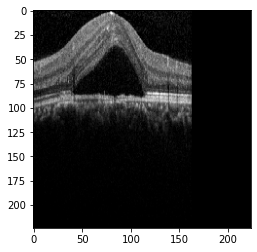

1/1 [==============================] - 0s 27ms/step
[[-2.529101  -2.8568141  3.9272268]]
Crop VKH , 392.72
FM9706 15-07-16 LE_000012_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000018_cropped.png


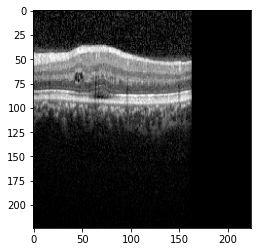

1/1 [==============================] - 0s 23ms/step
[[-2.5296786 -2.8618197  3.929756 ]]
Crop VKH , 392.98
FM9706 15-07-16 LE_000018_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000024_cropped.png


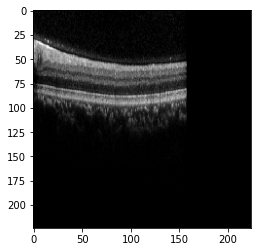

1/1 [==============================] - 0s 25ms/step
[[-2.5278203 -2.8550606  3.9253542]]
Crop VKH , 392.54
FM9706 15-07-16 LE_000024_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000010_cropped.png


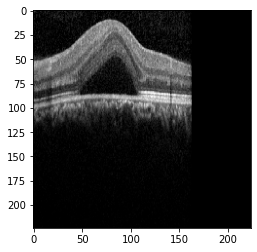

1/1 [==============================] - 0s 26ms/step
[[-2.5289462 -2.8581164  3.9275758]]
Crop VKH , 392.76
FM9706 15-07-16 LE_000010_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000011_cropped.png


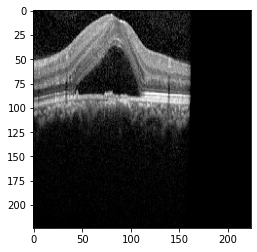

1/1 [==============================] - 0s 25ms/step
[[-2.528652  -2.862361   3.9304569]]
Crop VKH , 393.05
FM9706 15-07-16 LE_000011_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000022_cropped.png


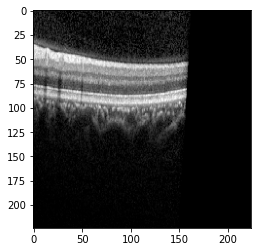

1/1 [==============================] - 0s 26ms/step
[[-2.530537  -2.858978   3.9280107]]
Crop VKH , 392.80
FM9706 15-07-16 LE_000022_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000013_cropped.png


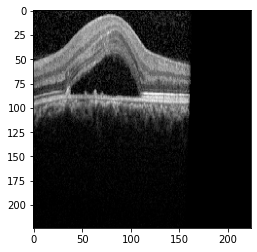

1/1 [==============================] - 0s 24ms/step
[[-2.5288162 -2.8608096  3.9292057]]
Crop VKH , 392.92
FM9706 15-07-16 LE_000013_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000009_cropped.png


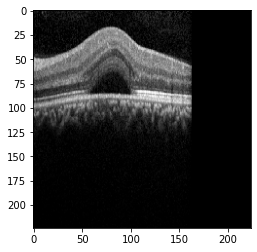

1/1 [==============================] - 0s 24ms/step
[[-2.5286715 -2.8581152  3.9274576]]
Crop VKH , 392.75
FM9706 15-07-16 LE_000009_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000016_cropped.png


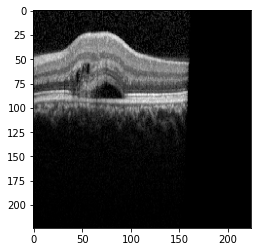

1/1 [==============================] - 0s 25ms/step
[[-2.5283566 -2.8602848  3.9284904]]
Crop VKH , 392.85
FM9706 15-07-16 LE_000016_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000015_cropped.png


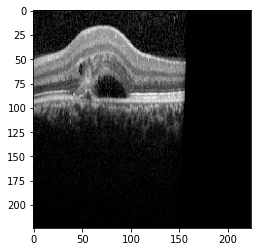

1/1 [==============================] - 0s 24ms/step
[[-2.5288148 -2.8608985  3.9289513]]
Crop VKH , 392.90
FM9706 15-07-16 LE_000015_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001001_cropped.png


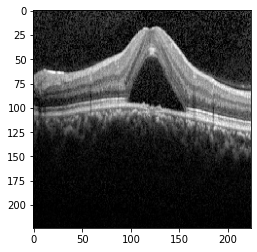

1/1 [==============================] - 0s 24ms/step
[[-2.5363693 -2.8614402  3.9341133]]
Crop VKH , 393.41
FM9706 15-07-16 LE_001001_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000023_cropped.png


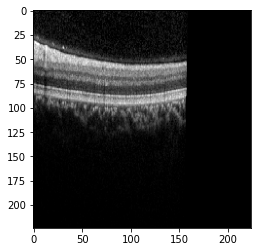

1/1 [==============================] - 0s 23ms/step
[[-2.5291512 -2.857523   3.9272807]]
Crop VKH , 392.73
FM9706 15-07-16 LE_000023_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000017_cropped.png


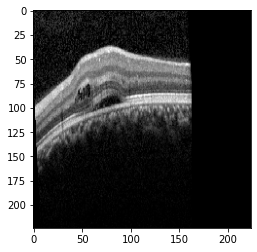

1/1 [==============================] - 0s 23ms/step
[[-2.5299177 -2.8600414  3.929063 ]]
Crop VKH , 392.91
FM9706 15-07-16 LE_000017_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_000021_cropped.png


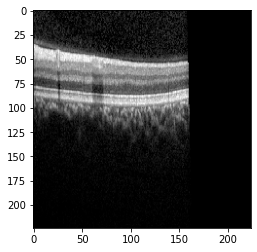

1/1 [==============================] - 0s 27ms/step
[[-2.529217  -2.8609185  3.928779 ]]
Crop VKH , 392.88
FM9706 15-07-16 LE_000021_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001003_cropped.png


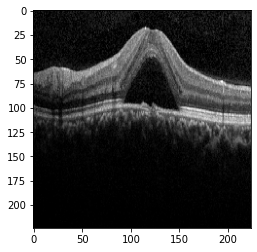

1/1 [==============================] - 0s 24ms/step
[[-2.5319262 -2.8585205  3.930228 ]]
Crop VKH , 393.02
FM9706 15-07-16 LE_001003_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001000_cropped.png


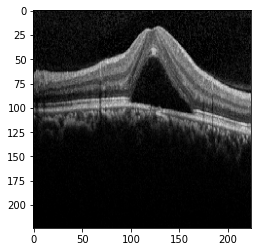

1/1 [==============================] - 0s 24ms/step
[[-2.532968  -2.8582053  3.9305785]]
Crop VKH , 393.06
FM9706 15-07-16 LE_001000_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_000_cropped.png


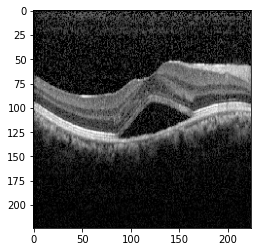

1/1 [==============================] - 0s 27ms/step
[[-2.548657  -2.8677816  3.946071 ]]
Crop VKH , 394.61
FN5911 25-06-12 RE_000_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001004_cropped.png


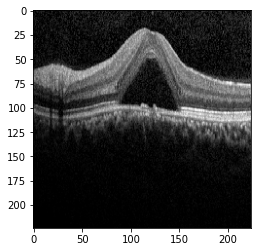

1/1 [==============================] - 0s 24ms/step
[[-2.5333693 -2.8594565  3.9317455]]
Crop VKH , 393.17
FM9706 15-07-16 LE_001004_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001000_cropped.png


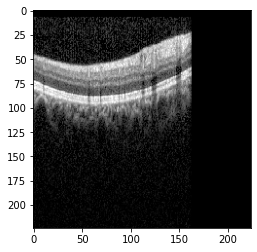

1/1 [==============================] - 0s 25ms/step
[[-2.5295336 -2.8675382  3.9349253]]
Crop VKH , 393.49
FN5911 25-06-12 RE_001000_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001006_cropped.png


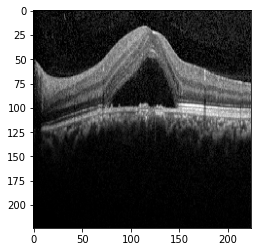

1/1 [==============================] - 0s 23ms/step
[[-2.5338883 -2.857989   3.930362 ]]
Crop VKH , 393.04
FM9706 15-07-16 LE_001006_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001007_cropped.png


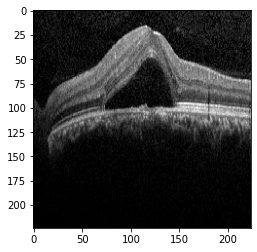

1/1 [==============================] - 0s 23ms/step
[[-2.5337398 -2.8594565  3.9316995]]
Crop VKH , 393.17
FM9706 15-07-16 LE_001007_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001008_cropped.png


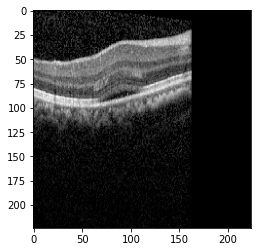

1/1 [==============================] - 0s 23ms/step
[[-2.5289168 -2.8673878  3.934807 ]]
Crop VKH , 393.48
FN5911 25-06-12 RE_001008_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001011_cropped.png


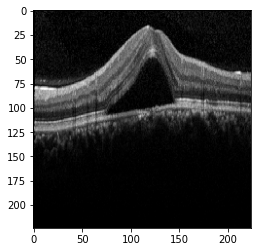

1/1 [==============================] - 0s 24ms/step
[[-2.532579  -2.8562648  3.9289472]]
Crop VKH , 392.89
FM9706 15-07-16 LE_001011_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_002_cropped.png


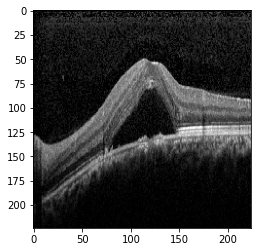

1/1 [==============================] - 0s 24ms/step
[[-2.5378742 -2.862296   3.9361908]]
Crop VKH , 393.62
FM9706 15-07-16 LE_002_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001008_cropped.png


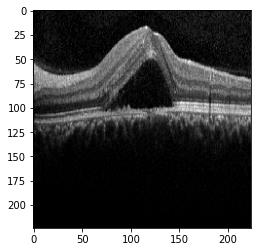

1/1 [==============================] - 0s 24ms/step
[[-2.531316  -2.8580546  3.9293735]]
Crop VKH , 392.94
FM9706 15-07-16 LE_001008_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001005_cropped.png


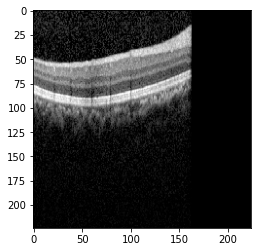

1/1 [==============================] - 0s 24ms/step
[[-2.528932  -2.8662283  3.9331114]]
Crop VKH , 393.31
FN5911 25-06-12 RE_001005_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001010_cropped.png


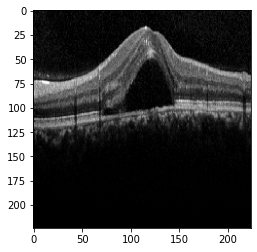

1/1 [==============================] - 0s 24ms/step
[[-2.5315    -2.857504   3.9293797]]
Crop VKH , 392.94
FM9706 15-07-16 LE_001010_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001005_cropped.png


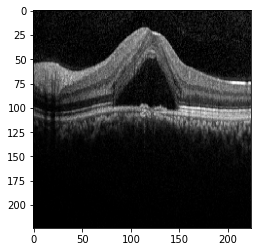

1/1 [==============================] - 0s 25ms/step
[[-2.5312955 -2.858239   3.9298632]]
Crop VKH , 392.99
FM9706 15-07-16 LE_001005_cropped.png: Crop VKH
--------------------------------------------
FM9706 15-07-16 LE_001009_cropped.png


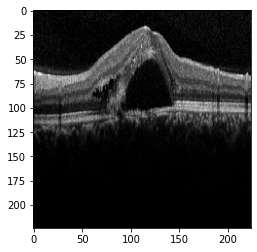

1/1 [==============================] - 0s 24ms/step
[[-2.530784  -2.857541   3.9291375]]
Crop VKH , 392.91
FM9706 15-07-16 LE_001009_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001002_cropped.png


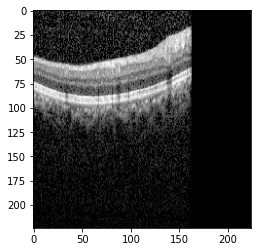

1/1 [==============================] - 0s 24ms/step
[[-2.533103  -2.8718429  3.9397795]]
Crop VKH , 393.98
FN5911 25-06-12 RE_001002_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001001_cropped.png


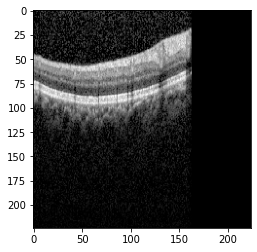

1/1 [==============================] - 0s 33ms/step
[[-2.5318127 -2.8670478  3.9358115]]
Crop VKH , 393.58
FN5911 25-06-12 RE_001001_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001020_cropped.png


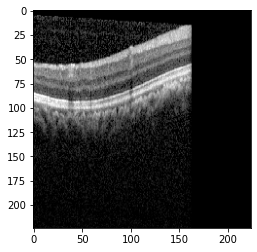

1/1 [==============================] - 0s 26ms/step
[[-2.5285351 -2.8684373  3.934501 ]]
Crop VKH , 393.45
FN5911 25-06-12 RE_001020_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001013_cropped.png


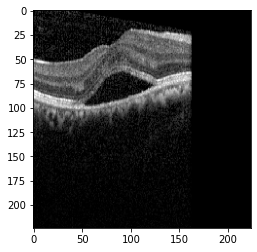

1/1 [==============================] - 0s 22ms/step
[[-2.5262754 -2.8651223  3.932162 ]]
Crop VKH , 393.22
FN5911 25-06-12 RE_001013_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001003_cropped.png


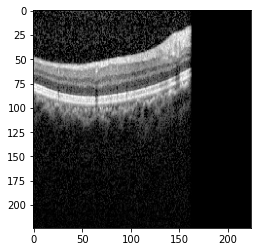

1/1 [==============================] - 0s 24ms/step
[[-2.532486  -2.8707767  3.937938 ]]
Crop VKH , 393.79
FN5911 25-06-12 RE_001003_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_002000_cropped.png


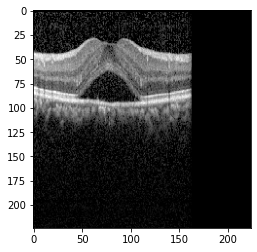

1/1 [==============================] - 0s 25ms/step
[[-2.529023  -2.8719404  3.9371386]]
Crop VKH , 393.71
FN5911 25-06-12 RE_002000_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001017_cropped.png


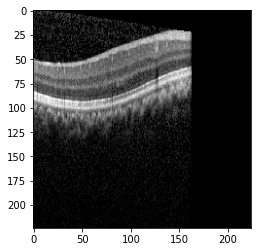

1/1 [==============================] - 0s 37ms/step
[[-2.5272474 -2.8656766  3.9322817]]
Crop VKH , 393.23
FN5911 25-06-12 RE_001017_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001009_cropped.png


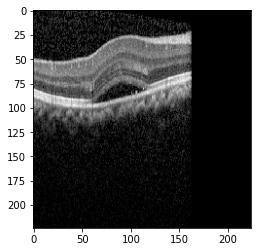

1/1 [==============================] - 0s 25ms/step
[[-2.526546  -2.868558   3.9342911]]
Crop VKH , 393.43
FN5911 25-06-12 RE_001009_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001016_cropped.png


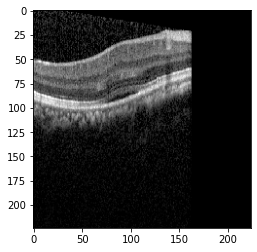

1/1 [==============================] - 0s 26ms/step
[[-2.5280235 -2.8659554  3.9331744]]
Crop VKH , 393.32
FN5911 25-06-12 RE_001016_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001014_cropped.png


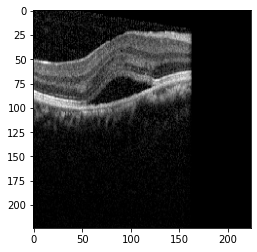

1/1 [==============================] - 0s 23ms/step
[[-2.5270705 -2.8634121  3.9313796]]
Crop VKH , 393.14
FN5911 25-06-12 RE_001014_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001010_cropped.png


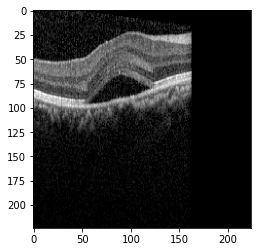

1/1 [==============================] - 0s 22ms/step
[[-2.5270395 -2.8641815  3.9318266]]
Crop VKH , 393.18
FN5911 25-06-12 RE_001010_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001015_cropped.png


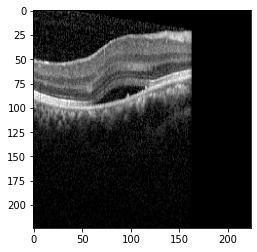

1/1 [==============================] - 0s 27ms/step
[[-2.525761  -2.8670936  3.9327867]]
Crop VKH , 393.28
FN5911 25-06-12 RE_001015_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001004_cropped.png


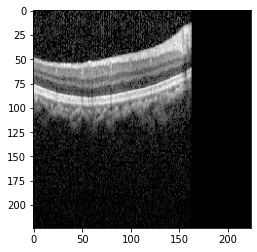

1/1 [==============================] - 0s 24ms/step
[[-2.5335505 -2.870108   3.937865 ]]
Crop VKH , 393.79
FN5911 25-06-12 RE_001004_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001012_cropped.png


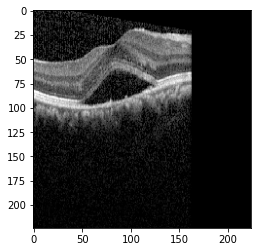

1/1 [==============================] - 0s 22ms/step
[[-2.5256453 -2.8693805  3.9348943]]
Crop VKH , 393.49
FN5911 25-06-12 RE_001012_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001007_cropped.png


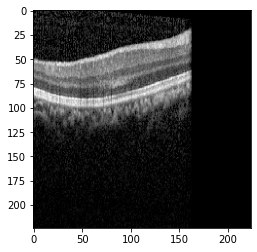

1/1 [==============================] - 0s 23ms/step
[[-2.5296857 -2.8658817  3.9332843]]
Crop VKH , 393.33
FN5911 25-06-12 RE_001007_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001018_cropped.png


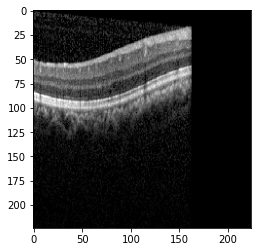

1/1 [==============================] - 0s 26ms/step
[[-2.5280302 -2.8639967  3.9312906]]
Crop VKH , 393.13
FN5911 25-06-12 RE_001018_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001011_cropped.png


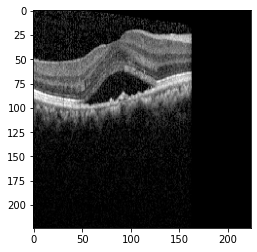

1/1 [==============================] - 0s 24ms/step
[[-2.5262148 -2.8667169  3.9331064]]
Crop VKH , 393.31
FN5911 25-06-12 RE_001011_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001006_cropped.png


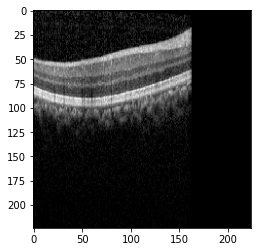

1/1 [==============================] - 0s 23ms/step
[[-2.528999  -2.8616061  3.9302628]]
Crop VKH , 393.03
FN5911 25-06-12 RE_001006_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001024_cropped.png


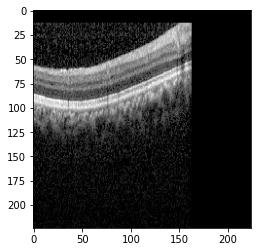

1/1 [==============================] - 0s 25ms/step
[[-2.5290823 -2.8705077  3.9364316]]
Crop VKH , 393.64
FN5911 25-06-12 RE_001024_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_002005_cropped.png


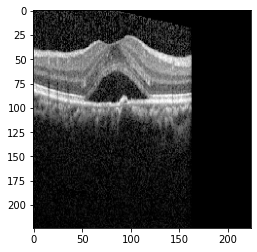

1/1 [==============================] - 0s 24ms/step
[[-2.5273542 -2.8704875  3.9346044]]
Crop VKH , 393.46
FN5911 25-06-12 RE_002005_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_002004_cropped.png


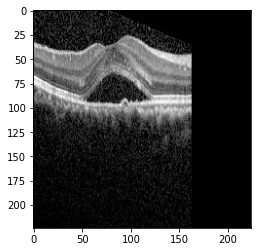

1/1 [==============================] - 0s 24ms/step
[[-2.5245373 -2.8702073  3.9333832]]
Crop VKH , 393.34
FN5911 25-06-12 RE_002004_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001021_cropped.png


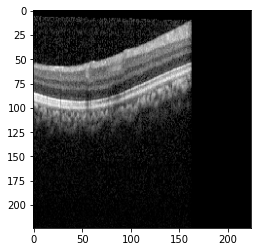

1/1 [==============================] - 0s 27ms/step
[[-2.529498  -2.8651514  3.9325206]]
Crop VKH , 393.25
FN5911 25-06-12 RE_001021_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_002002_cropped.png


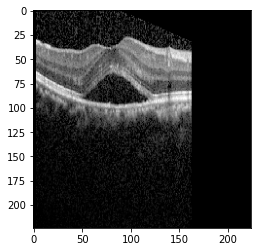

1/1 [==============================] - 0s 32ms/step
[[-2.5266192 -2.8694158  3.9347131]]
Crop VKH , 393.47
FN5911 25-06-12 RE_002002_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_002003_cropped.png


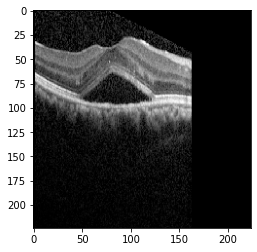

1/1 [==============================] - 0s 24ms/step
[[-2.5262969 -2.8639727  3.9298294]]
Crop VKH , 392.98
FN5911 25-06-12 RE_002003_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001019_cropped.png


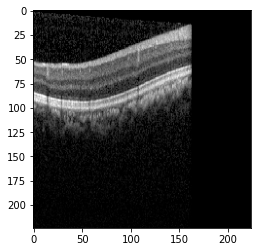

1/1 [==============================] - 0s 27ms/step
[[-2.529537  -2.86238    3.9309723]]
Crop VKH , 393.10
FN5911 25-06-12 RE_001019_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001023_cropped.png


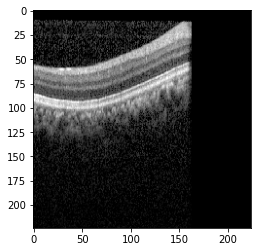

1/1 [==============================] - 0s 24ms/step
[[-2.528034  -2.8702784  3.9356558]]
Crop VKH , 393.57
FN5911 25-06-12 RE_001023_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_002001_cropped.png


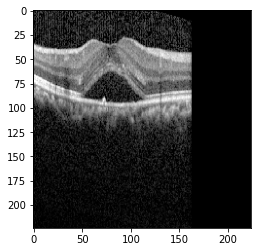

1/1 [==============================] - 0s 29ms/step
[[-2.5278294 -2.8694973  3.934333 ]]
Crop VKH , 393.43
FN5911 25-06-12 RE_002001_cropped.png: Crop VKH
--------------------------------------------
FN5911 25-06-12 RE_001022_cropped.png


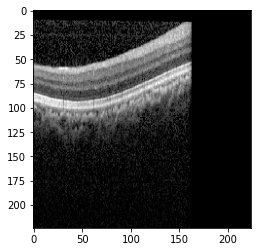

1/1 [==============================] - 0s 24ms/step
[[-2.5281837 -2.8689656  3.9346542]]
Crop VKH , 393.47
FN5911 25-06-12 RE_001022_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001006_cropped.png


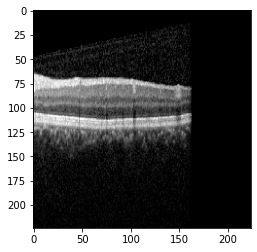

1/1 [==============================] - 0s 24ms/step
[[-2.5280802 -2.8625226  3.9302301]]
Crop VKH , 393.02
CS5305 13-09-17 LE_001006_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001013_cropped.png


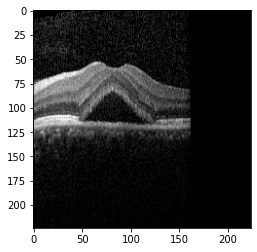

1/1 [==============================] - 0s 24ms/step
[[-2.530513  -2.8630786  3.932081 ]]
Crop VKH , 393.21
CS5305 13-09-17 LE_001013_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001017_cropped.png


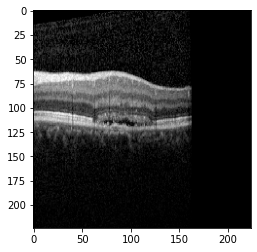

1/1 [==============================] - 0s 121ms/step
[[-2.5314493 -2.861301   3.9310398]]
Crop VKH , 393.10
CS5305 13-09-17 LE_001017_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001000_cropped.png


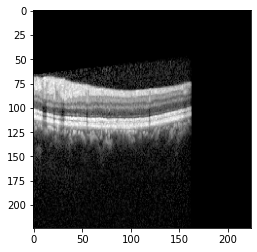

1/1 [==============================] - 0s 25ms/step
[[-2.526465  -2.8587956  3.9256542]]
Crop VKH , 392.57
CS5305 13-09-17 LE_001000_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001005_cropped.png


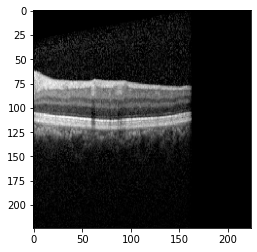

1/1 [==============================] - 0s 64ms/step
[[-2.5306559 -2.8603182  3.9295824]]
Crop VKH , 392.96
CS5305 13-09-17 LE_001005_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001007_cropped.png


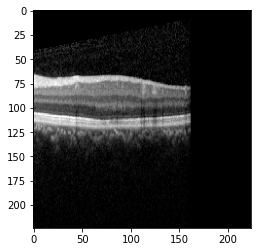

1/1 [==============================] - 0s 39ms/step
[[-2.5287225 -2.858695   3.9273226]]
Crop VKH , 392.73
CS5305 13-09-17 LE_001007_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001008_cropped.png


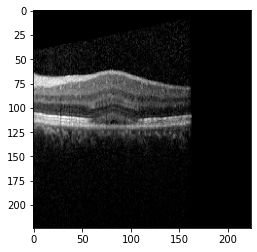

1/1 [==============================] - 0s 23ms/step
[[-2.5261033 -2.8627648  3.9306386]]
Crop VKH , 393.06
CS5305 13-09-17 LE_001008_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001002_cropped.png


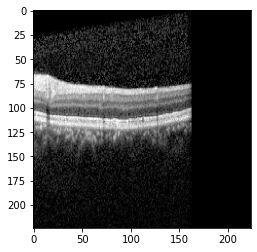

1/1 [==============================] - 0s 25ms/step
[[-2.5328004 -2.863222   3.932165 ]]
Crop VKH , 393.22
CS5305 13-09-17 LE_001002_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001003_cropped.png


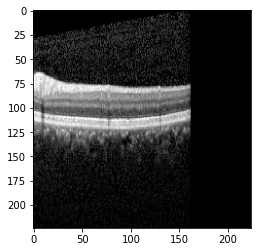

1/1 [==============================] - 0s 38ms/step
[[-2.5319302 -2.8615117  3.9303162]]
Crop VKH , 393.03
CS5305 13-09-17 LE_001003_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001009_cropped.png


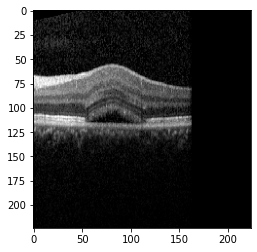

1/1 [==============================] - 0s 31ms/step
[[-2.5313509 -2.8598533  3.930489 ]]
Crop VKH , 393.05
CS5305 13-09-17 LE_001009_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001004_cropped.png


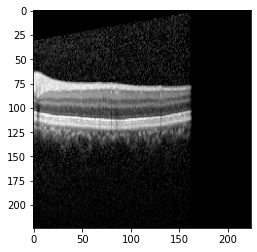

1/1 [==============================] - 0s 24ms/step
[[-2.5317705 -2.8601384  3.9291742]]
Crop VKH , 392.92
CS5305 13-09-17 LE_001004_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001011_cropped.png


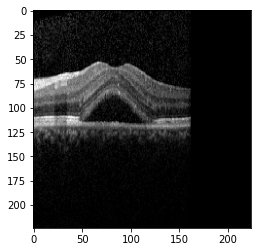

1/1 [==============================] - 0s 25ms/step
[[-2.5296068 -2.86037    3.9297917]]
Crop VKH , 392.98
CS5305 13-09-17 LE_001011_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001001_cropped.png


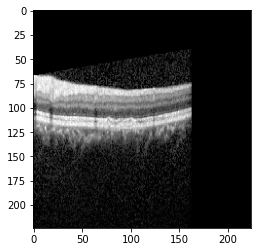

1/1 [==============================] - 0s 23ms/step
[[-2.5257893 -2.8630033  3.928473 ]]
Crop VKH , 392.85
CS5305 13-09-17 LE_001001_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_000_cropped.png


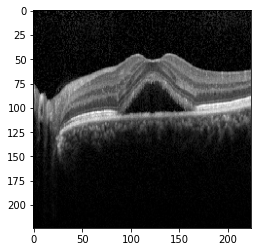

1/1 [==============================] - 0s 24ms/step
[[-2.5369577 -2.856793   3.9300182]]
Crop VKH , 393.00
CS5305 13-09-17 LE_000_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001010_cropped.png


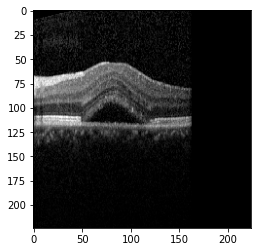

1/1 [==============================] - 0s 25ms/step
[[-2.5296204 -2.8611507  3.9309247]]
Crop VKH , 393.09
CS5305 13-09-17 LE_001010_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001022_cropped.png


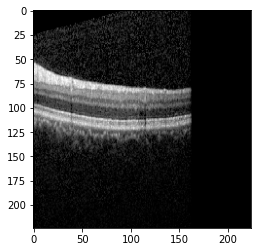

1/1 [==============================] - 0s 25ms/step
[[-2.5317566 -2.862308   3.9322073]]
Crop VKH , 393.22
CS5305 13-09-17 LE_001022_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002001_cropped.png


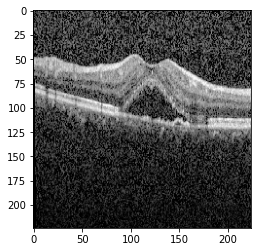

1/1 [==============================] - 0s 26ms/step
[[-2.5534356 -2.8835862  3.9604566]]
Crop VKH , 396.05
CS5305 13-09-17 LE_002001_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001018_cropped.png


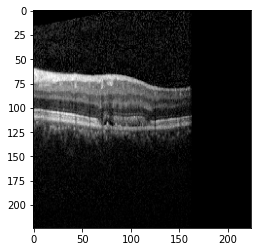

1/1 [==============================] - 0s 23ms/step
[[-2.5309496 -2.8612032  3.9316676]]
Crop VKH , 393.17
CS5305 13-09-17 LE_001018_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002002_cropped.png


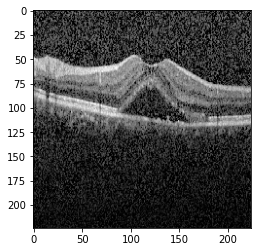

1/1 [==============================] - 0s 24ms/step
[[-2.551183  -2.8804026  3.9573472]]
Crop VKH , 395.73
CS5305 13-09-17 LE_002002_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001024_cropped.png


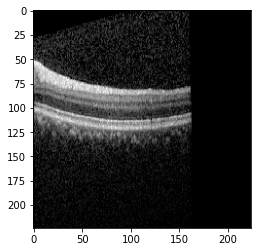

1/1 [==============================] - 0s 29ms/step
[[-2.5317428 -2.8650432  3.9347563]]
Crop VKH , 393.48
CS5305 13-09-17 LE_001024_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001023_cropped.png


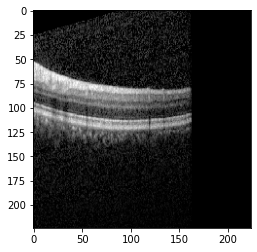

1/1 [==============================] - 0s 24ms/step
[[-2.53334   -2.8642836  3.9348176]]
Crop VKH , 393.48
CS5305 13-09-17 LE_001023_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001014_cropped.png


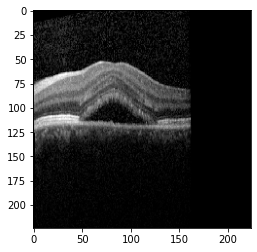

1/1 [==============================] - 0s 23ms/step
[[-2.529941  -2.8624382  3.9310925]]
Crop VKH , 393.11
CS5305 13-09-17 LE_001014_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002003_cropped.png


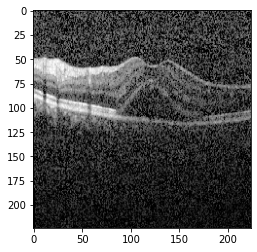

1/1 [==============================] - 0s 22ms/step
[[-2.5507748 -2.8897288  3.965052 ]]
Crop VKH , 396.51
CS5305 13-09-17 LE_002003_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002006_cropped.png


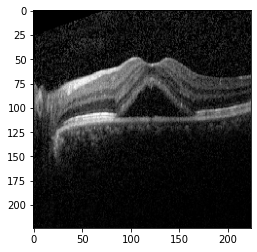

1/1 [==============================] - 0s 23ms/step
[[-2.5381296 -2.8620768  3.9361987]]
Crop VKH , 393.62
CS5305 13-09-17 LE_002006_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001020_cropped.png


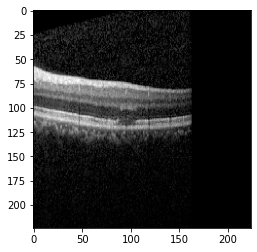

1/1 [==============================] - 0s 24ms/step
[[-2.5316923 -2.862106   3.9325569]]
Crop VKH , 393.26
CS5305 13-09-17 LE_001020_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001021_cropped.png


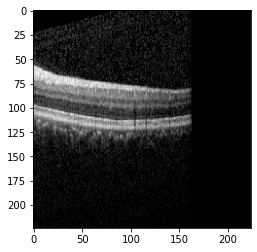

1/1 [==============================] - 0s 34ms/step
[[-2.5319674 -2.8628178  3.933321 ]]
Crop VKH , 393.33
CS5305 13-09-17 LE_001021_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002000_cropped.png


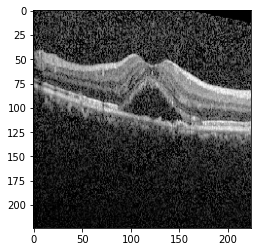

1/1 [==============================] - 0s 23ms/step
[[-2.549061  -2.8803527  3.955692 ]]
Crop VKH , 395.57
CS5305 13-09-17 LE_002000_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001015_cropped.png


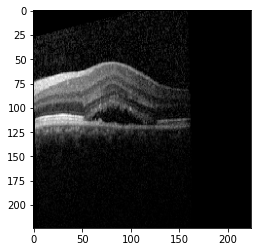

1/1 [==============================] - 0s 25ms/step
[[-2.5274415 -2.8631794  3.9309359]]
Crop VKH , 393.09
CS5305 13-09-17 LE_001015_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001019_cropped.png


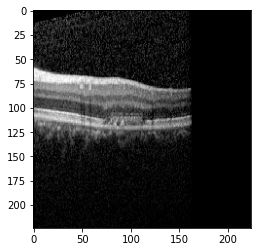

1/1 [==============================] - 0s 30ms/step
[[-2.5351236 -2.8605905  3.9326973]]
Crop VKH , 393.27
CS5305 13-09-17 LE_001019_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001012_cropped.png


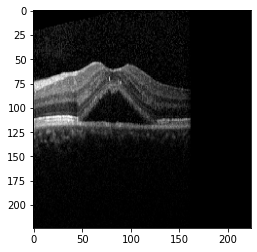

1/1 [==============================] - 0s 24ms/step
[[-2.5278037 -2.861075   3.9299018]]
Crop VKH , 392.99
CS5305 13-09-17 LE_001012_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_001016_cropped.png


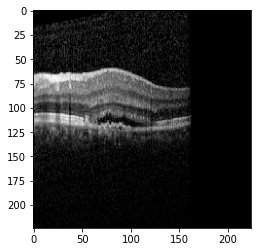

1/1 [==============================] - 0s 22ms/step
[[-2.5299513 -2.8634028  3.9330873]]
Crop VKH , 393.31
CS5305 13-09-17 LE_001016_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002010_cropped.png


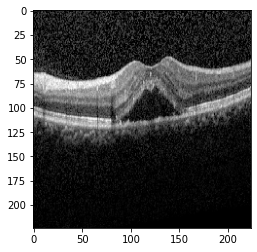

1/1 [==============================] - 0s 25ms/step
[[-2.544308  -2.8630824  3.939193 ]]
Crop VKH , 393.92
CS5305 13-09-17 LE_002010_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002005_cropped.png


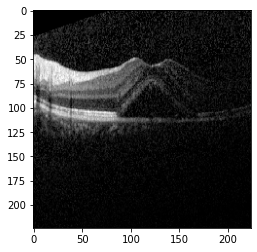

1/1 [==============================] - 0s 25ms/step
[[-2.532766 -2.865025  3.935972]]
Crop VKH , 393.60
CS5305 13-09-17 LE_002005_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002004_cropped.png


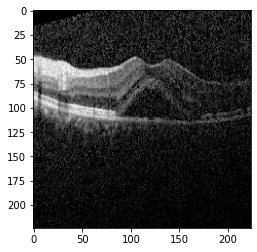

1/1 [==============================] - 0s 24ms/step
[[-2.5381067 -2.8730588  3.9452336]]
Crop VKH , 394.52
CS5305 13-09-17 LE_002004_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002009_cropped.png


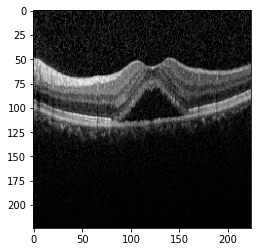

1/1 [==============================] - 0s 29ms/step
[[-2.538212  -2.8593674  3.934457 ]]
Crop VKH , 393.45
CS5305 13-09-17 LE_002009_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002008_cropped.png


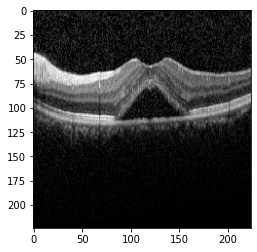

1/1 [==============================] - 0s 23ms/step
[[-2.536824  -2.8605464  3.9339585]]
Crop VKH , 393.40
CS5305 13-09-17 LE_002008_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002011_cropped.png


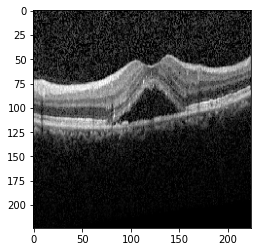

1/1 [==============================] - 0s 23ms/step
[[-2.5444295 -2.8648186  3.9405186]]
Crop VKH , 394.05
CS5305 13-09-17 LE_002011_cropped.png: Crop VKH
--------------------------------------------
CS5305 13-09-17 LE_002007_cropped.png


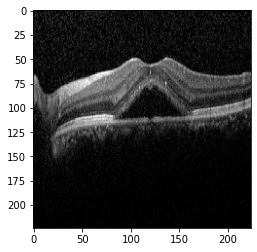

1/1 [==============================] - 0s 23ms/step
[[-2.538489  -2.85788    3.9330285]]
Crop VKH , 393.30
CS5305 13-09-17 LE_002007_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001012_cropped.png


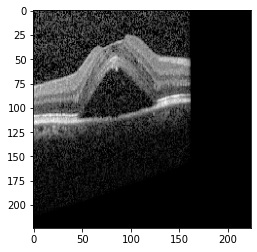

1/1 [==============================] - 0s 33ms/step
[[-2.5322478 -2.869973   3.9384894]]
Crop VKH , 393.85
FQ8979 17-01-12 LE_001012_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001000_cropped.png


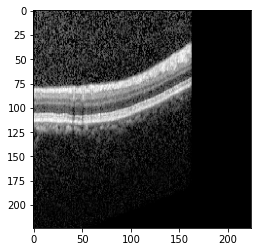

1/1 [==============================] - 0s 22ms/step
[[-2.5411386 -2.8641398  3.9375198]]
Crop VKH , 393.75
FQ8979 17-01-12 LE_001000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001010_cropped.png


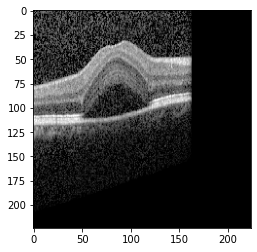

1/1 [==============================] - 0s 28ms/step
[[-2.534039  -2.870668   3.9397748]]
Crop VKH , 393.98
FQ8979 17-01-12 LE_001010_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001006_cropped.png


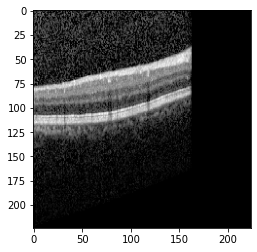

1/1 [==============================] - 0s 24ms/step
[[-2.5390067 -2.8615296  3.9352539]]
Crop VKH , 393.53
FQ8979 17-01-12 LE_001006_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001001_cropped.png


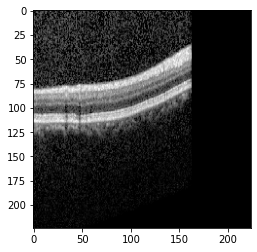

1/1 [==============================] - 0s 24ms/step
[[-2.5400236 -2.862061   3.9356275]]
Crop VKH , 393.56
FQ8979 17-01-12 LE_001001_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001011_cropped.png


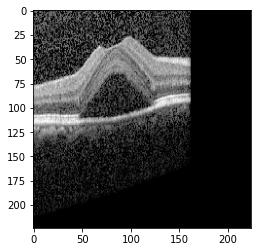

1/1 [==============================] - 0s 22ms/step
[[-2.5325058 -2.877131   3.9437673]]
Crop VKH , 394.38
FQ8979 17-01-12 LE_001011_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001004_cropped.png


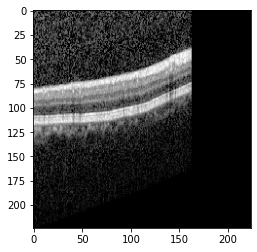

1/1 [==============================] - 0s 23ms/step
[[-2.5409606 -2.86497    3.9385264]]
Crop VKH , 393.85
FQ8979 17-01-12 LE_001004_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001002_cropped.png


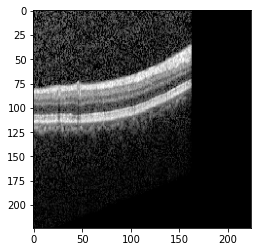

1/1 [==============================] - 0s 24ms/step
[[-2.5413399 -2.8632863  3.937543 ]]
Crop VKH , 393.75
FQ8979 17-01-12 LE_001002_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_000_cropped.png


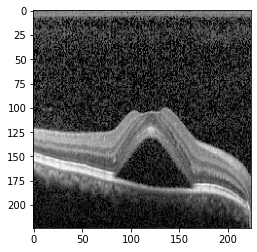

1/1 [==============================] - 0s 23ms/step
[[-2.5599082 -2.858518   3.9489467]]
Crop VKH , 394.89
FQ8979 17-01-12 LE_000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001005_cropped.png


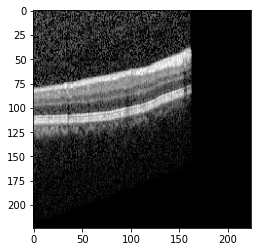

1/1 [==============================] - 0s 22ms/step
[[-2.5403244 -2.8631113  3.9367795]]
Crop VKH , 393.68
FQ8979 17-01-12 LE_001005_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001003_cropped.png


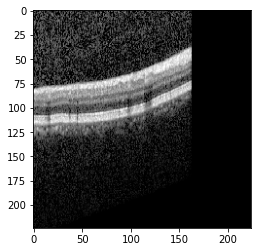

1/1 [==============================] - 0s 30ms/step
[[-2.541112  -2.8643732  3.9382312]]
Crop VKH , 393.82
FQ8979 17-01-12 LE_001003_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001014_cropped.png


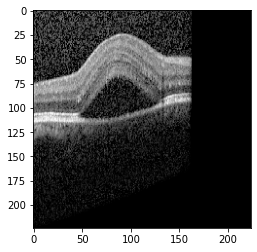

1/1 [==============================] - 0s 24ms/step
[[-2.5318305 -2.8721733  3.9402707]]
Crop VKH , 394.03
FQ8979 17-01-12 LE_001014_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001013_cropped.png


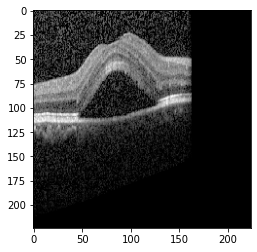

1/1 [==============================] - 0s 22ms/step
[[-2.5317447 -2.8695965  3.9379683]]
Crop VKH , 393.80
FQ8979 17-01-12 LE_001013_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_002003_cropped.png


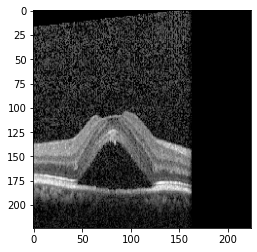

1/1 [==============================] - 0s 23ms/step
[[-2.5391476 -2.8662462  3.9421892]]
Crop VKH , 394.22
FQ8979 17-01-12 LE_002003_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001020_cropped.png


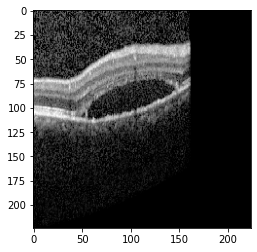

1/1 [==============================] - 0s 24ms/step
[[-2.5310757 -2.8720355  3.9402583]]
Crop VKH , 394.03
FQ8979 17-01-12 LE_001020_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001009_cropped.png


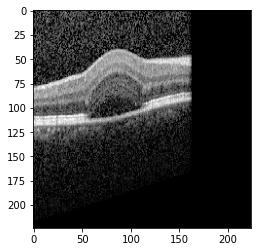

1/1 [==============================] - 0s 24ms/step
[[-2.53511   -2.8717208  3.9411385]]
Crop VKH , 394.11
FQ8979 17-01-12 LE_001009_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001022_cropped.png


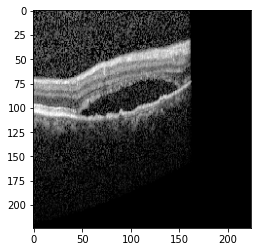

1/1 [==============================] - 0s 23ms/step
[[-2.533168  -2.8712373  3.94109  ]]
Crop VKH , 394.11
FQ8979 17-01-12 LE_001022_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001021_cropped.png


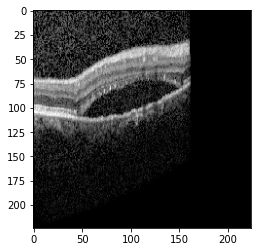

1/1 [==============================] - 0s 22ms/step
[[-2.5330408 -2.8686807  3.9389985]]
Crop VKH , 393.90
FQ8979 17-01-12 LE_001021_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001018_cropped.png


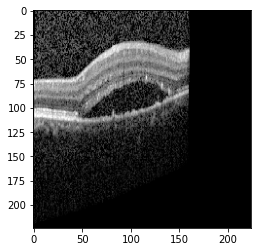

1/1 [==============================] - 0s 22ms/step
[[-2.530682  -2.8723922  3.940142 ]]
Crop VKH , 394.01
FQ8979 17-01-12 LE_001018_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001016_cropped.png


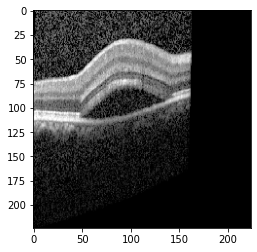

1/1 [==============================] - 0s 26ms/step
[[-2.531852  -2.8734493  3.9400775]]
Crop VKH , 394.01
FQ8979 17-01-12 LE_001016_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001017_cropped.png


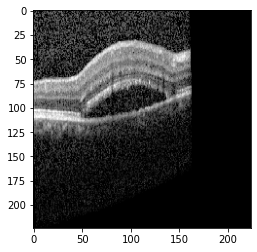

1/1 [==============================] - 0s 24ms/step
[[-2.5340216 -2.8704033  3.9400866]]
Crop VKH , 394.01
FQ8979 17-01-12 LE_001017_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001007_cropped.png


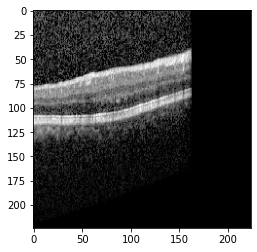

1/1 [==============================] - 0s 23ms/step
[[-2.5365448 -2.8666646  3.9384325]]
Crop VKH , 393.84
FQ8979 17-01-12 LE_001007_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001024_cropped.png


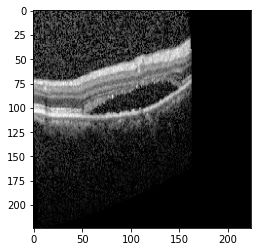

1/1 [==============================] - 0s 23ms/step
[[-2.5355628 -2.8675346  3.938834 ]]
Crop VKH , 393.88
FQ8979 17-01-12 LE_001024_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_002001_cropped.png


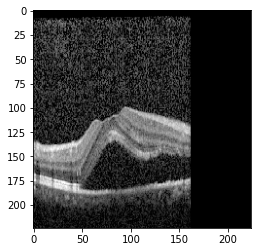

1/1 [==============================] - 0s 23ms/step
[[-2.5432813 -2.8624177  3.9405973]]
Crop VKH , 394.06
FQ8979 17-01-12 LE_002001_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001019_cropped.png


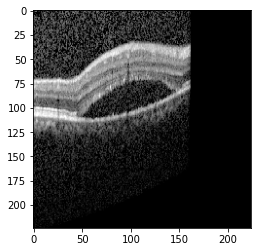

1/1 [==============================] - 0s 24ms/step
[[-2.5321147 -2.8720374  3.9404871]]
Crop VKH , 394.05
FQ8979 17-01-12 LE_001019_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001015_cropped.png


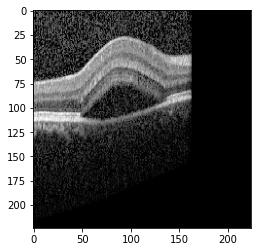

1/1 [==============================] - 0s 24ms/step
[[-2.532455  -2.869898   3.9385586]]
Crop VKH , 393.86
FQ8979 17-01-12 LE_001015_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001008_cropped.png


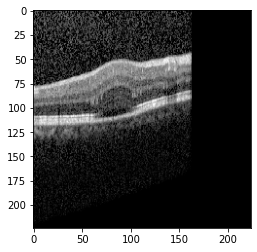

1/1 [==============================] - 0s 25ms/step
[[-2.5366356 -2.8653107  3.9372902]]
Crop VKH , 393.73
FQ8979 17-01-12 LE_001008_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000006_cropped.png


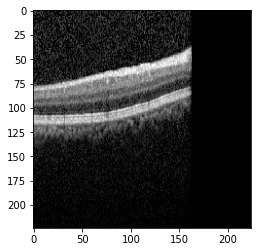

1/1 [==============================] - 0s 25ms/step
[[-2.5360365 -2.862908   3.9345496]]
Crop VKH , 393.45
FQ8979 14-02-12 RE_000006_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000010_cropped.png


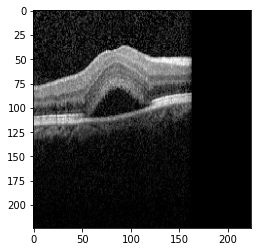

1/1 [==============================] - 0s 25ms/step
[[-2.5307894 -2.865293   3.9337823]]
Crop VKH , 393.38
FQ8979 14-02-12 RE_000010_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_002004_cropped.png


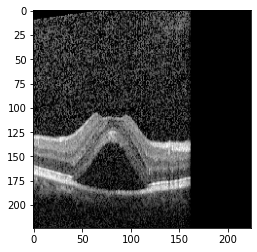

1/1 [==============================] - 0s 32ms/step
[[-2.5425885 -2.8707583  3.9480991]]
Crop VKH , 394.81
FQ8979 17-01-12 LE_002004_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000007_cropped.png


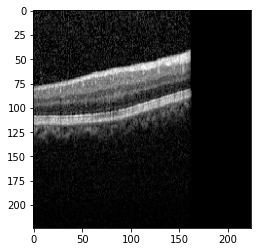

1/1 [==============================] - 0s 27ms/step
[[-2.5331075 -2.8609812  3.9321616]]
Crop VKH , 393.22
FQ8979 14-02-12 RE_000007_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000009_cropped.png


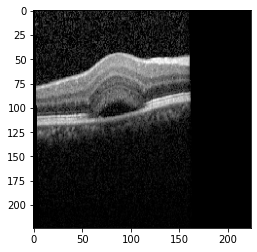

1/1 [==============================] - 0s 22ms/step
[[-2.5323598 -2.8619764  3.931418 ]]
Crop VKH , 393.14
FQ8979 14-02-12 RE_000009_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000001_cropped.png


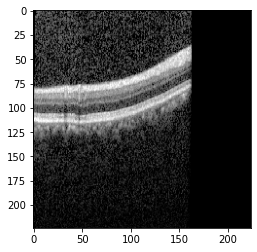

1/1 [==============================] - 0s 24ms/step
[[-2.5403168 -2.8673632  3.939717 ]]
Crop VKH , 393.97
FQ8979 14-02-12 RE_000001_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_001023_cropped.png


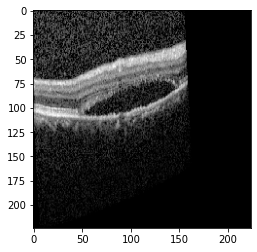

1/1 [==============================] - 0s 23ms/step
[[-2.5330288 -2.8688684  3.9388297]]
Crop VKH , 393.88
FQ8979 17-01-12 LE_001023_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000005_cropped.png


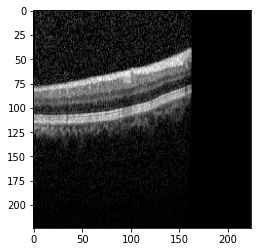

1/1 [==============================] - 0s 24ms/step
[[-2.5344708 -2.8607955  3.9322739]]
Crop VKH , 393.23
FQ8979 14-02-12 RE_000005_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_002000_cropped.png


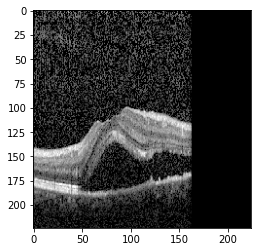

1/1 [==============================] - 0s 23ms/step
[[-2.5526116 -2.8692617  3.9522583]]
Crop VKH , 395.23
FQ8979 17-01-12 LE_002000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000002_cropped.png


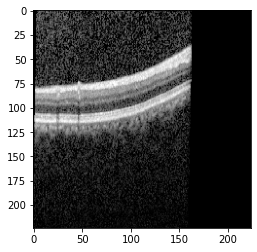

1/1 [==============================] - 0s 25ms/step
[[-2.5409055 -2.866136   3.938391 ]]
Crop VKH , 393.84
FQ8979 14-02-12 RE_000002_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000000_cropped.png


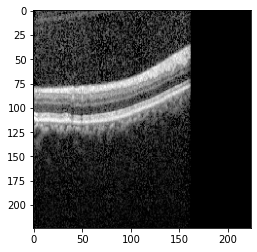

1/1 [==============================] - 0s 24ms/step
[[-2.5389087 -2.8681827  3.9389985]]
Crop VKH , 393.90
FQ8979 14-02-12 RE_000000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000008_cropped.png


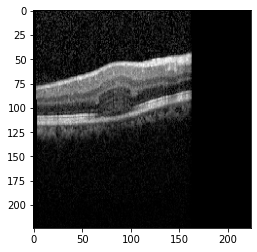

1/1 [==============================] - 0s 24ms/step
[[-2.5324042 -2.8607872  3.9315841]]
Crop VKH , 393.16
FQ8979 14-02-12 RE_000008_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000003_cropped.png


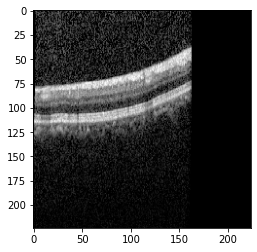

1/1 [==============================] - 0s 25ms/step
[[-2.5382748 -2.8651354  3.9372644]]
Crop VKH , 393.73
FQ8979 14-02-12 RE_000003_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_002002_cropped.png


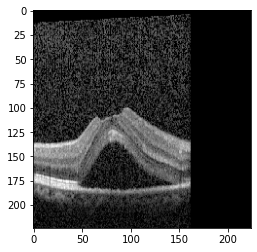

1/1 [==============================] - 0s 23ms/step
[[-2.5415702 -2.8642545  3.9417307]]
Crop VKH , 394.17
FQ8979 17-01-12 LE_002002_cropped.png: Crop VKH
--------------------------------------------
FQ8979 17-01-12 LE_002005_cropped.png


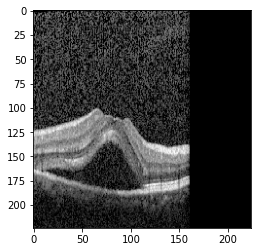

1/1 [==============================] - 0s 22ms/step
[[-2.543109  -2.8669224  3.9443314]]
Crop VKH , 394.43
FQ8979 17-01-12 LE_002005_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000011_cropped.png


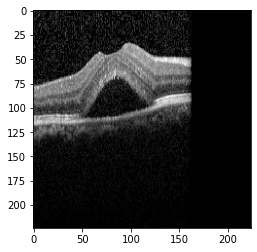

1/1 [==============================] - 0s 23ms/step
[[-2.5322492 -2.8624845  3.9320357]]
Crop VKH , 393.20
FQ8979 14-02-12 RE_000011_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000004_cropped.png


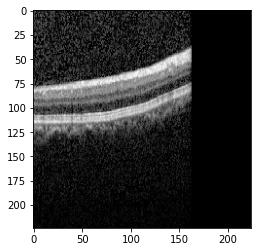

1/1 [==============================] - 0s 25ms/step
[[-2.537103  -2.8641765  3.9357784]]
Crop VKH , 393.58
FQ8979 14-02-12 RE_000004_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000013_cropped.png


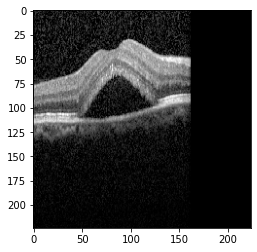

1/1 [==============================] - 0s 24ms/step
[[-2.5298526 -2.8661985  3.9334524]]
Crop VKH , 393.35
FQ8979 14-02-12 RE_000013_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000015_cropped.png


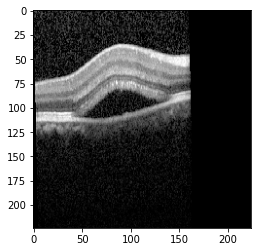

1/1 [==============================] - 0s 24ms/step
[[-2.5304544 -2.8670819  3.9331903]]
Crop VKH , 393.32
FQ8979 14-02-12 RE_000015_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_001001_cropped.png


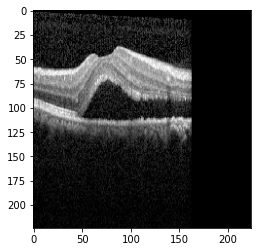

1/1 [==============================] - 0s 30ms/step
[[-2.5293496 -2.867879   3.9340336]]
Crop VKH , 393.40
FQ8979 14-02-12 RE_001001_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_001003_cropped.png


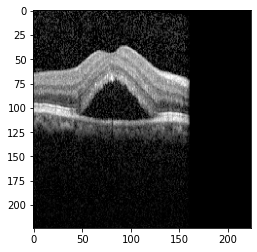

1/1 [==============================] - 0s 23ms/step
[[-2.530009  -2.8704624  3.936506 ]]
Crop VKH , 393.65
FQ8979 14-02-12 RE_001003_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000018_cropped.png


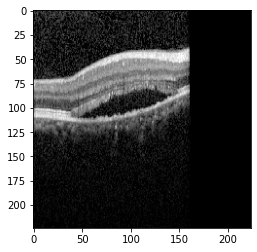

1/1 [==============================] - 0s 28ms/step
[[-2.5289528 -2.8676825  3.9342613]]
Crop VKH , 393.43
FQ8979 14-02-12 RE_000018_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000019_cropped.png


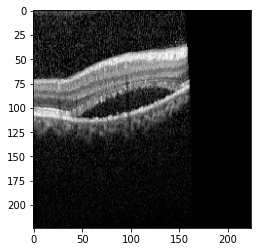

1/1 [==============================] - 0s 22ms/step
[[-2.5289397 -2.867454   3.9346676]]
Crop VKH , 393.47
FQ8979 14-02-12 RE_000019_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000024_cropped.png


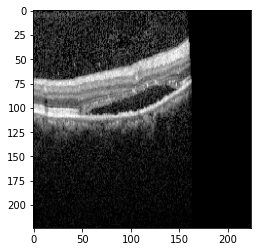

1/1 [==============================] - 0s 24ms/step
[[-2.5326436 -2.8679724  3.936388 ]]
Crop VKH , 393.64
FQ8979 14-02-12 RE_000024_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000016_cropped.png


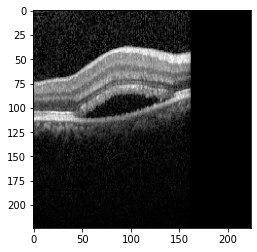

1/1 [==============================] - 0s 28ms/step
[[-2.5312264 -2.864158   3.9324992]]
Crop VKH , 393.25
FQ8979 14-02-12 RE_000016_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000017_cropped.png


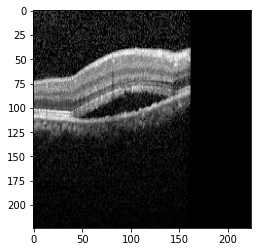

1/1 [==============================] - 0s 26ms/step
[[-2.5306551 -2.8666825  3.9346344]]
Crop VKH , 393.46
FQ8979 14-02-12 RE_000017_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000020_cropped.png


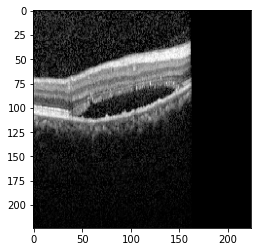

1/1 [==============================] - 0s 22ms/step
[[-2.5299842 -2.8674393  3.9349349]]
Crop VKH , 393.49
FQ8979 14-02-12 RE_000020_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000023_cropped.png


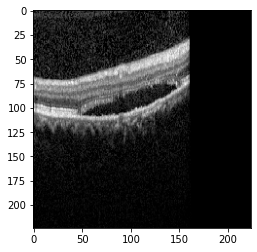

1/1 [==============================] - 0s 23ms/step
[[-2.530205  -2.8636494  3.9329731]]
Crop VKH , 393.30
FQ8979 14-02-12 RE_000023_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000012_cropped.png


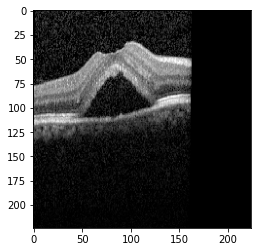

1/1 [==============================] - 0s 23ms/step
[[-2.5305789 -2.8657012  3.9338267]]
Crop VKH , 393.38
FQ8979 14-02-12 RE_000012_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000021_cropped.png


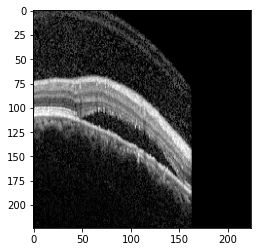

1/1 [==============================] - 0s 23ms/step
[[-2.5324872 -2.8688006  3.937713 ]]
Crop VKH , 393.77
FQ8979 14-02-12 RE_000021_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000022_cropped.png


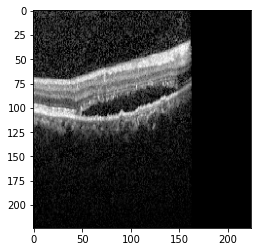

1/1 [==============================] - 0s 26ms/step
[[-2.531782  -2.8678522  3.9367068]]
Crop VKH , 393.67
FQ8979 14-02-12 RE_000022_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_000014_cropped.png


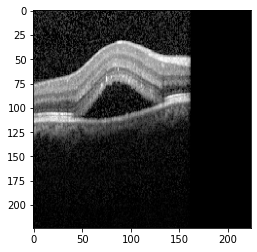

1/1 [==============================] - 0s 23ms/step
[[-2.5304954 -2.8658295  3.932803 ]]
Crop VKH , 393.28
FQ8979 14-02-12 RE_000014_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_001000_cropped.png


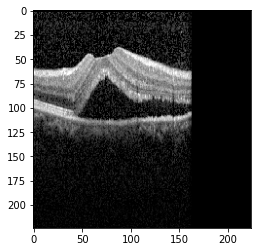

1/1 [==============================] - 0s 33ms/step
[[-2.531038  -2.8731608  3.940583 ]]
Crop VKH , 394.06
FQ8979 14-02-12 RE_001000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_001004_cropped.png


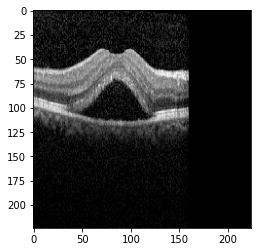

1/1 [==============================] - 0s 22ms/step
[[-2.5298612 -2.865001   3.9331725]]
Crop VKH , 393.32
FQ8979 14-02-12 RE_001004_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001014_cropped.png


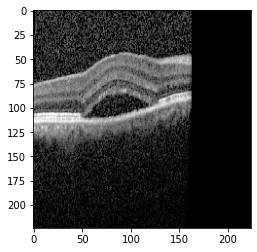

1/1 [==============================] - 0s 22ms/step
[[-2.535273  -2.8703551  3.9388435]]
Crop VKH , 393.88
FQ8979 23-03-12 RE_001014_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001003_cropped.png


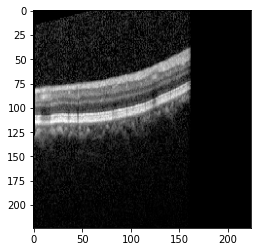

1/1 [==============================] - 0s 24ms/step
[[-2.5357504 -2.8596587  3.9311497]]
Crop VKH , 393.11
FQ8979 23-03-12 RE_001003_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001001_cropped.png


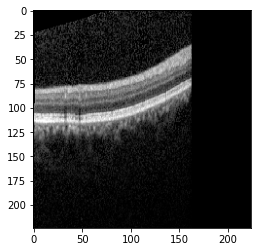

1/1 [==============================] - 0s 23ms/step
[[-2.5341775 -2.8606997  3.9312418]]
Crop VKH , 393.12
FQ8979 23-03-12 RE_001001_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001000_cropped.png


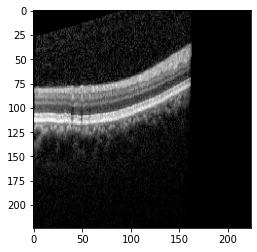

1/1 [==============================] - 0s 28ms/step
[[-2.5324948 -2.8605323  3.9302237]]
Crop VKH , 393.02
FQ8979 23-03-12 RE_001000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001007_cropped.png


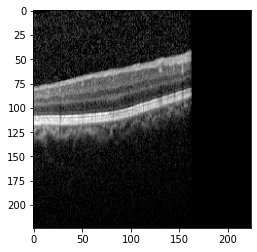

1/1 [==============================] - 0s 25ms/step
[[-2.5346527 -2.86102    3.9317904]]
Crop VKH , 393.18
FQ8979 23-03-12 RE_001007_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001009_cropped.png


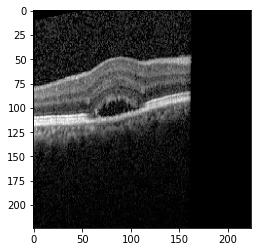

1/1 [==============================] - 0s 22ms/step
[[-2.5330617 -2.8652499  3.9347386]]
Crop VKH , 393.47
FQ8979 23-03-12 RE_001009_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001004_cropped.png


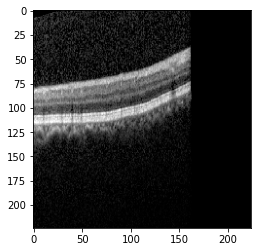

1/1 [==============================] - 0s 23ms/step
[[-2.535562  -2.8598216  3.9315505]]
Crop VKH , 393.16
FQ8979 23-03-12 RE_001004_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_001002_cropped.png


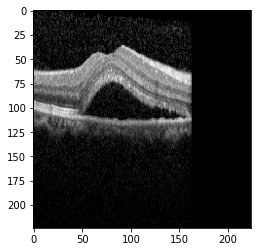

1/1 [==============================] - 0s 24ms/step
[[-2.5287857 -2.866849   3.9338481]]
Crop VKH , 393.38
FQ8979 14-02-12 RE_001002_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_002_cropped.png


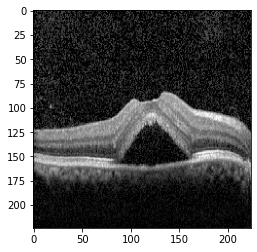

1/1 [==============================] - 0s 25ms/step
[[-2.5500057 -2.8570616  3.9404306]]
Crop VKH , 394.04
FQ8979 14-02-12 RE_002_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001006_cropped.png


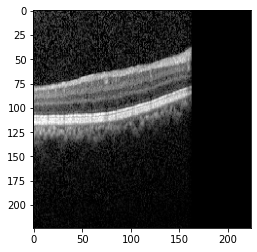

1/1 [==============================] - 0s 23ms/step
[[-2.5358942 -2.862441   3.933224 ]]
Crop VKH , 393.32
FQ8979 23-03-12 RE_001006_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001002_cropped.png


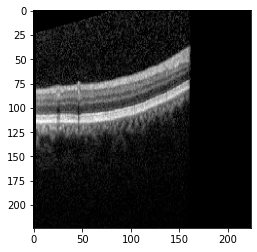

1/1 [==============================] - 0s 25ms/step
[[-2.5325801 -2.8606553  3.9304707]]
Crop VKH , 393.05
FQ8979 23-03-12 RE_001002_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001012_cropped.png


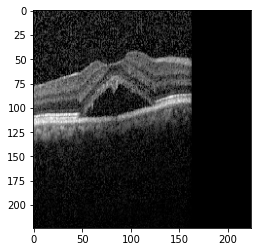

1/1 [==============================] - 0s 23ms/step
[[-2.5334156 -2.8667457  3.9368703]]
Crop VKH , 393.69
FQ8979 23-03-12 RE_001012_cropped.png: Crop VKH
--------------------------------------------
FQ8979 14-02-12 RE_001005_cropped.png


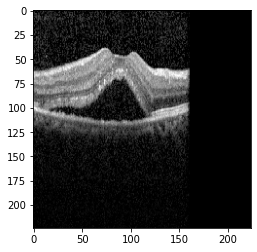

1/1 [==============================] - 0s 23ms/step
[[-2.5290232 -2.8683858  3.9350898]]
Crop VKH , 393.51
FQ8979 14-02-12 RE_001005_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_000_cropped.png


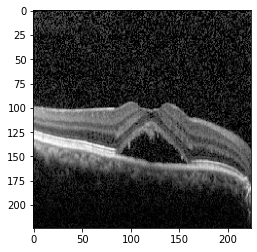

1/1 [==============================] - 0s 23ms/step
[[-2.553195  -2.8616974  3.945762 ]]
Crop VKH , 394.58
FQ8979 23-03-12 RE_000_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001010_cropped.png


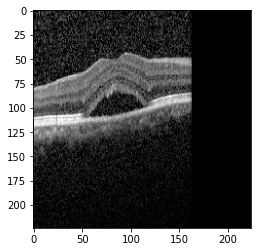

1/1 [==============================] - 0s 27ms/step
[[-2.5332944 -2.8678722  3.9365013]]
Crop VKH , 393.65
FQ8979 23-03-12 RE_001010_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001005_cropped.png


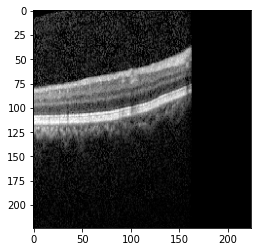

1/1 [==============================] - 0s 23ms/step
[[-2.5358915 -2.8638744  3.9340088]]
Crop VKH , 393.40
FQ8979 23-03-12 RE_001005_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_002004_cropped.png


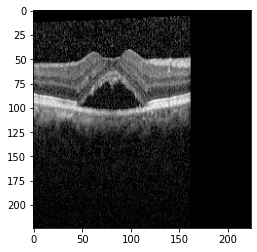

1/1 [==============================] - 0s 25ms/step
[[-2.5273156 -2.8706625  3.935431 ]]
Crop VKH , 393.54
FQ8979 23-03-12 RE_002004_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001020_cropped.png


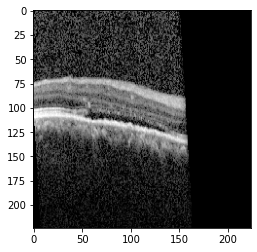

1/1 [==============================] - 0s 32ms/step
[[-2.5453415 -2.865344   3.9402473]]
Crop VKH , 394.02
FQ8979 23-03-12 RE_001020_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_002001_cropped.png


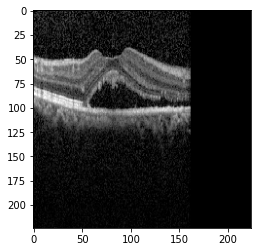

1/1 [==============================] - 0s 24ms/step
[[-2.5285566 -2.8671932  3.9337394]]
Crop VKH , 393.37
FQ8979 23-03-12 RE_002001_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001017_cropped.png


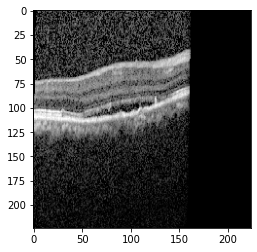

1/1 [==============================] - 0s 24ms/step
[[-2.5391183 -2.8716388  3.9417894]]
Crop VKH , 394.18
FQ8979 23-03-12 RE_001017_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001019_cropped.png


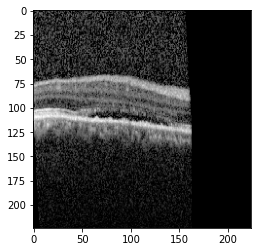

1/1 [==============================] - 0s 24ms/step
[[-2.5417228 -2.8677504  3.9408917]]
Crop VKH , 394.09
FQ8979 23-03-12 RE_001019_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001008_cropped.png


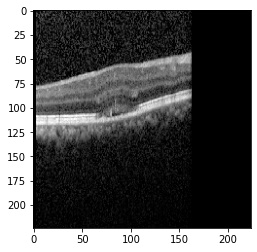

1/1 [==============================] - 0s 25ms/step
[[-2.5353622 -2.8624396  3.9329827]]
Crop VKH , 393.30
FQ8979 23-03-12 RE_001008_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_002003_cropped.png


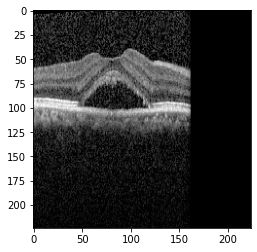

1/1 [==============================] - 0s 28ms/step
[[-2.5298822 -2.8723013  3.938041 ]]
Crop VKH , 393.80
FQ8979 23-03-12 RE_002003_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001018_cropped.png


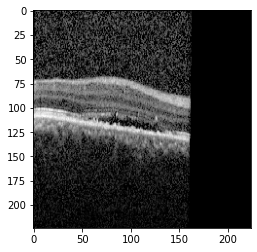

1/1 [==============================] - 0s 25ms/step
[[-2.5437384 -2.8684149  3.9428349]]
Crop VKH , 394.28
FQ8979 23-03-12 RE_001018_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001024_cropped.png


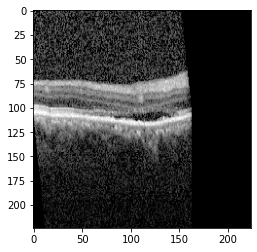

1/1 [==============================] - 0s 27ms/step
[[-2.5438583 -2.8669958  3.9397342]]
Crop VKH , 393.97
FQ8979 23-03-12 RE_001024_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001016_cropped.png


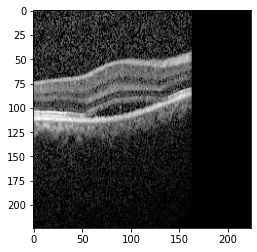

1/1 [==============================] - 0s 24ms/step
[[-2.5379407 -2.8698106  3.9405801]]
Crop VKH , 394.06
FQ8979 23-03-12 RE_001016_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001022_cropped.png


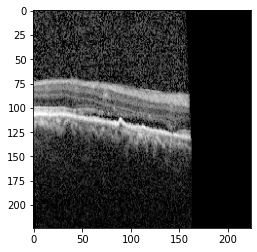

1/1 [==============================] - 0s 23ms/step
[[-2.5436776 -2.8669076  3.9407618]]
Crop VKH , 394.08
FQ8979 23-03-12 RE_001022_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001011_cropped.png


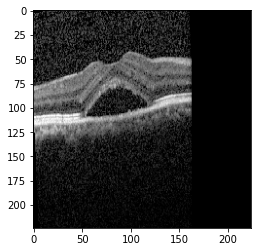

1/1 [==============================] - 0s 23ms/step
[[-2.5333438 -2.8690429  3.9376073]]
Crop VKH , 393.76
FQ8979 23-03-12 RE_001011_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001013_cropped.png


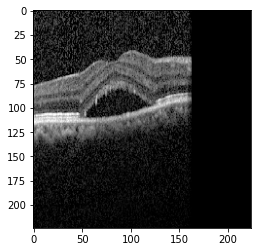

1/1 [==============================] - 0s 24ms/step
[[-2.5338378 -2.8667812  3.936455 ]]
Crop VKH , 393.65
FQ8979 23-03-12 RE_001013_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001015_cropped.png


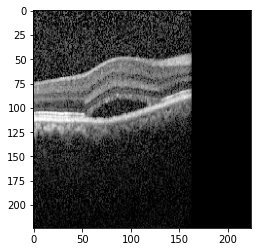

1/1 [==============================] - 0s 25ms/step
[[-2.5387309 -2.869751   3.9399183]]
Crop VKH , 393.99
FQ8979 23-03-12 RE_001015_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001023_cropped.png


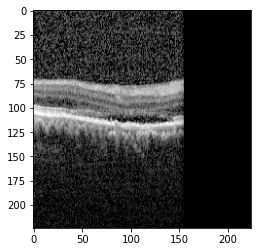

1/1 [==============================] - 0s 25ms/step
[[-2.542615  -2.8668182  3.9396477]]
Crop VKH , 393.96
FQ8979 23-03-12 RE_001023_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_001021_cropped.png


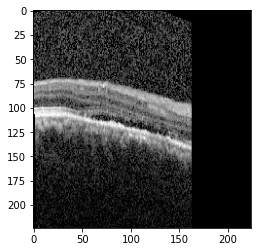

1/1 [==============================] - 0s 25ms/step
[[-2.5444782 -2.8666553  3.941674 ]]
Crop VKH , 394.17
FQ8979 23-03-12 RE_001021_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000003_cropped.png


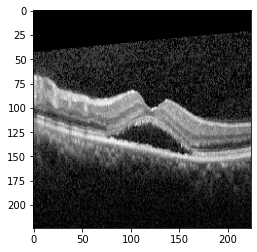

1/1 [==============================] - 0s 36ms/step
[[-2.5346308 -2.8660698  3.9375665]]
Crop VKH , 393.76
CL8574 25-03-16 LE_000003_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000005_cropped.png


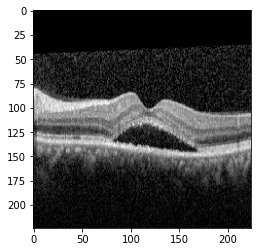

1/1 [==============================] - 0s 24ms/step
[[-2.5307662 -2.8659177  3.9360442]]
Crop VKH , 393.60
CL8574 25-03-16 LE_000005_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000001_cropped.png


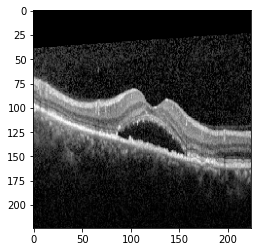

1/1 [==============================] - 0s 24ms/step
[[-2.5325625 -2.8680234  3.938355 ]]
Crop VKH , 393.84
CL8574 25-03-16 LE_000001_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000006_cropped.png


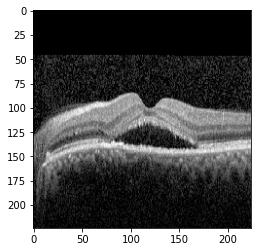

1/1 [==============================] - 0s 24ms/step
[[-2.5305305 -2.8617435  3.933246 ]]
Crop VKH , 393.32
CL8574 25-03-16 LE_000006_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_002000_cropped.png


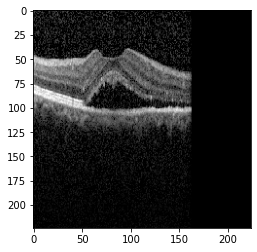

1/1 [==============================] - 0s 27ms/step
[[-2.5292995 -2.8722985  3.939261 ]]
Crop VKH , 393.93
FQ8979 23-03-12 RE_002000_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000002_cropped.png


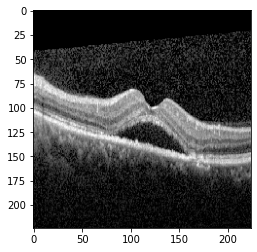

1/1 [==============================] - 0s 23ms/step
[[-2.5362437 -2.8694751  3.9415205]]
Crop VKH , 394.15
CL8574 25-03-16 LE_000002_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000009_cropped.png


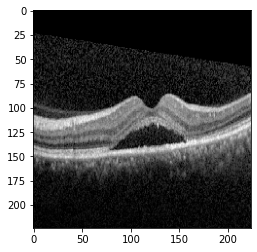

1/1 [==============================] - 0s 24ms/step
[[-2.5296638 -2.860714   3.931349 ]]
Crop VKH , 393.13
CL8574 25-03-16 LE_000009_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_002002_cropped.png


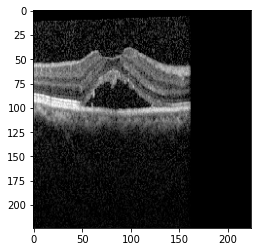

1/1 [==============================] - 0s 27ms/step
[[-2.5264473 -2.8723638  3.9368079]]
Crop VKH , 393.68
FQ8979 23-03-12 RE_002002_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000007_cropped.png


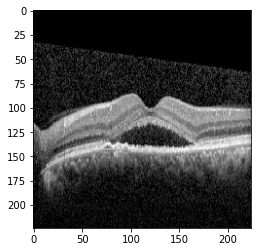

1/1 [==============================] - 0s 26ms/step
[[-2.530121  -2.8584733  3.9299772]]
Crop VKH , 393.00
CL8574 25-03-16 LE_000007_cropped.png: Crop VKH
--------------------------------------------
FQ8979 23-03-12 RE_002005_cropped.png


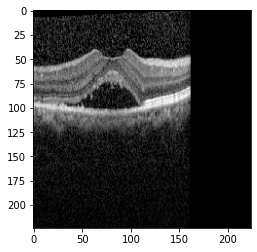

1/1 [==============================] - 0s 26ms/step
[[-2.5284173 -2.8689218  3.934446 ]]
Crop VKH , 393.44
FQ8979 23-03-12 RE_002005_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000004_cropped.png


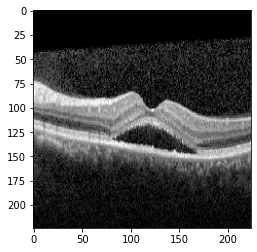

1/1 [==============================] - 0s 26ms/step
[[-2.53346   -2.8662386  3.9369588]]
Crop VKH , 393.70
CL8574 25-03-16 LE_000004_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002000_cropped.png


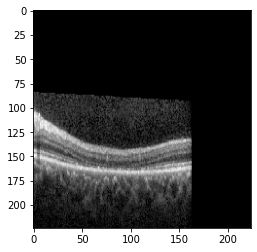

1/1 [==============================] - 0s 22ms/step
[[-2.5203292 -2.8663278  3.9301503]]
Crop VKH , 393.02
CL8574 25-03-16 LE_002000_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000008_cropped.png


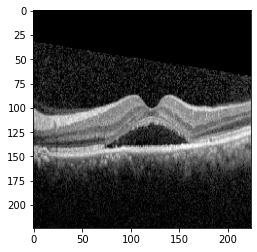

1/1 [==============================] - 0s 29ms/step
[[-2.528016  -2.861968   3.9312222]]
Crop VKH , 393.12
CL8574 25-03-16 LE_000008_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000010_cropped.png


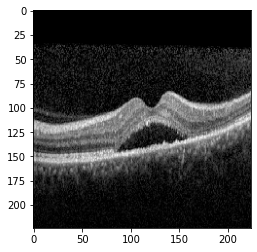

1/1 [==============================] - 0s 24ms/step
[[-2.5301533 -2.8636127  3.934319 ]]
Crop VKH , 393.43
CL8574 25-03-16 LE_000010_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000000_cropped.png


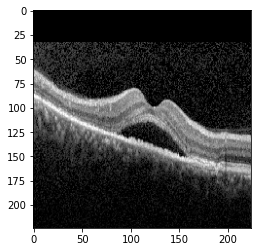

1/1 [==============================] - 0s 36ms/step
[[-2.5338445 -2.8689415  3.9404514]]
Crop VKH , 394.05
CL8574 25-03-16 LE_000000_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002013_cropped.png


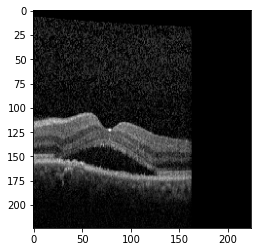

1/1 [==============================] - 0s 23ms/step
[[-2.5295973 -2.868392   3.9368856]]
Crop VKH , 393.69
CL8574 25-03-16 LE_002013_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002012_cropped.png


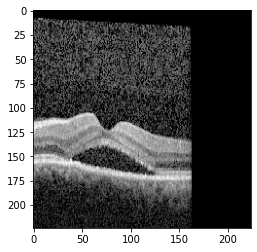

1/1 [==============================] - 0s 23ms/step
[[-2.542141  -2.8691216  3.9455264]]
Crop VKH , 394.55
CL8574 25-03-16 LE_002012_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002011_cropped.png


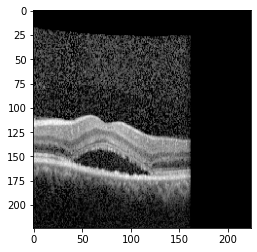

1/1 [==============================] - 0s 29ms/step
[[-2.534413  -2.866723   3.9401228]]
Crop VKH , 394.01
CL8574 25-03-16 LE_002011_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002001_cropped.png


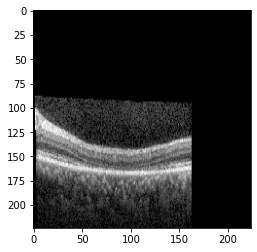

1/1 [==============================] - 0s 28ms/step
[[-2.5194194 -2.868044   3.9311445]]
Crop VKH , 393.11
CL8574 25-03-16 LE_002001_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002002_cropped.png


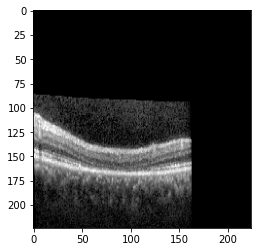

1/1 [==============================] - 0s 24ms/step
[[-2.5193326 -2.8677897  3.9306579]]
Crop VKH , 393.07
CL8574 25-03-16 LE_002002_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002007_cropped.png


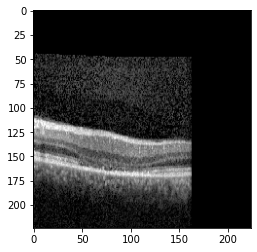

1/1 [==============================] - 0s 25ms/step
[[-2.525379  -2.8651996  3.934583 ]]
Crop VKH , 393.46
CL8574 25-03-16 LE_002007_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002005_cropped.png


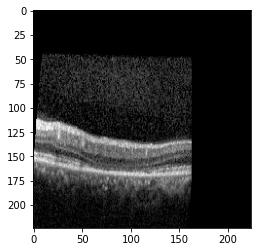

1/1 [==============================] - 0s 22ms/step
[[-2.523431  -2.8670564  3.9343202]]
Crop VKH , 393.43
CL8574 25-03-16 LE_002005_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002016_cropped.png


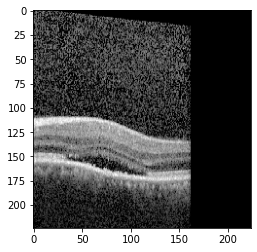

1/1 [==============================] - 0s 23ms/step
[[-2.5466592 -2.8665605  3.9460487]]
Crop VKH , 394.60
CL8574 25-03-16 LE_002016_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002014_cropped.png


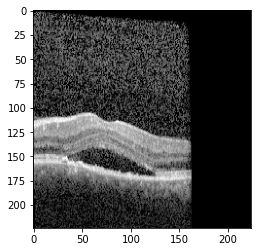

1/1 [==============================] - 0s 22ms/step
[[-2.5471094 -2.8652415  3.9450567]]
Crop VKH , 394.51
CL8574 25-03-16 LE_002014_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_000011_cropped.png


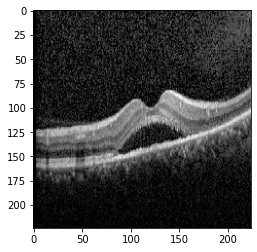

1/1 [==============================] - 0s 28ms/step
[[-2.5426807 -2.861618   3.9389765]]
Crop VKH , 393.90
CL8574 25-03-16 LE_000011_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_001_cropped.png


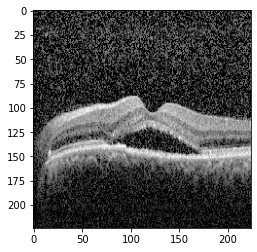

1/1 [==============================] - 0s 30ms/step
[[-2.572996  -2.8662176  3.9605844]]
Crop VKH , 396.06
CL8574 25-03-16 LE_001_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002010_cropped.png


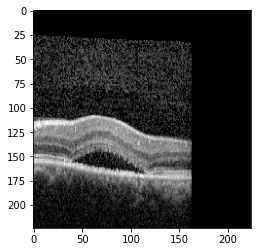

1/1 [==============================] - 0s 23ms/step
[[-2.5314975 -2.8660305  3.9375813]]
Crop VKH , 393.76
CL8574 25-03-16 LE_002010_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002003_cropped.png


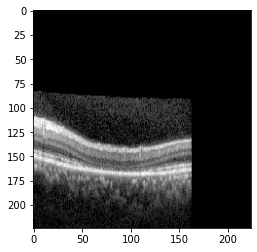

1/1 [==============================] - 0s 23ms/step
[[-2.5202112 -2.867004   3.9308684]]
Crop VKH , 393.09
CL8574 25-03-16 LE_002003_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002008_cropped.png


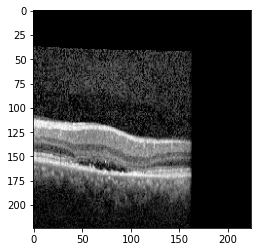

1/1 [==============================] - 0s 24ms/step
[[-2.528396 -2.866243  3.93666 ]]
Crop VKH , 393.67
CL8574 25-03-16 LE_002008_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002009_cropped.png


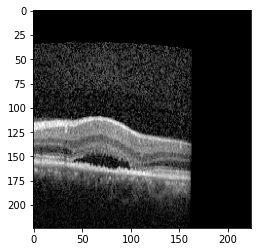

1/1 [==============================] - 0s 22ms/step
[[-2.5293038 -2.8665066  3.936924 ]]
Crop VKH , 393.69
CL8574 25-03-16 LE_002009_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002004_cropped.png


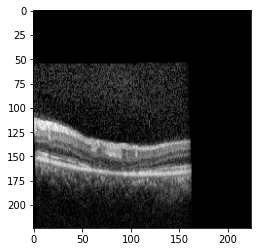

1/1 [==============================] - 0s 33ms/step
[[-2.5227082 -2.8677702  3.9345849]]
Crop VKH , 393.46
CL8574 25-03-16 LE_002004_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002006_cropped.png


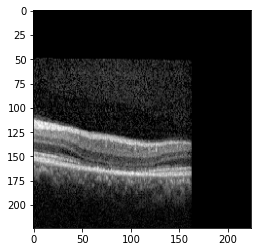

1/1 [==============================] - 0s 26ms/step
[[-2.5233128 -2.8664498  3.9336534]]
Crop VKH , 393.37
CL8574 25-03-16 LE_002006_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002020_cropped.png


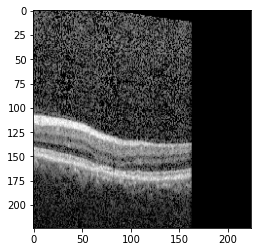

1/1 [==============================] - 0s 25ms/step
[[-2.5443027 -2.8742023  3.9521654]]
Crop VKH , 395.22
CL8574 25-03-16 LE_002020_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002022_cropped.png


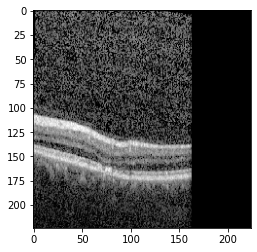

1/1 [==============================] - 0s 23ms/step
[[-2.5464153 -2.8736048  3.9527636]]
Crop VKH , 395.28
CL8574 25-03-16 LE_002022_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002017_cropped.png


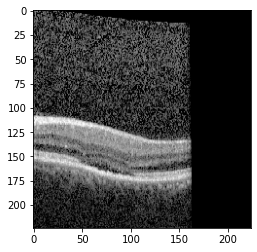

1/1 [==============================] - 0s 23ms/step
[[-2.5451133 -2.868137   3.9474943]]
Crop VKH , 394.75
CL8574 25-03-16 LE_002017_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002023_cropped.png


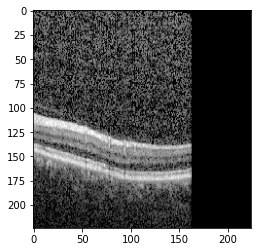

1/1 [==============================] - 0s 22ms/step
[[-2.5478122 -2.8746293  3.9548242]]
Crop VKH , 395.48
CL8574 25-03-16 LE_002023_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002024_cropped.png


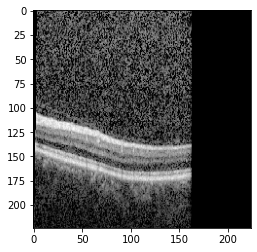

1/1 [==============================] - 0s 26ms/step
[[-2.5473716 -2.8739538  3.9539917]]
Crop VKH , 395.40
CL8574 25-03-16 LE_002024_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002018_cropped.png


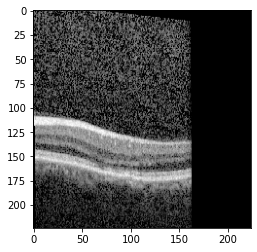

1/1 [==============================] - 0s 25ms/step
[[-2.547557  -2.867438   3.9488683]]
Crop VKH , 394.89
CL8574 25-03-16 LE_002018_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002021_cropped.png


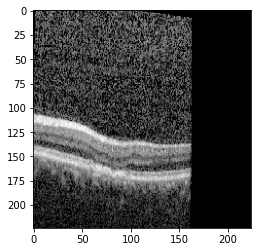

1/1 [==============================] - 0s 23ms/step
[[-2.5448525 -2.8737493  3.9525335]]
Crop VKH , 395.25
CL8574 25-03-16 LE_002021_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002019_cropped.png


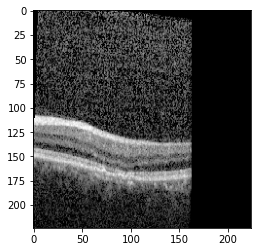

1/1 [==============================] - 0s 30ms/step
[[-2.5449812 -2.871829   3.95053  ]]
Crop VKH , 395.05
CL8574 25-03-16 LE_002019_cropped.png: Crop VKH
--------------------------------------------
CL8574 25-03-16 LE_002015_cropped.png


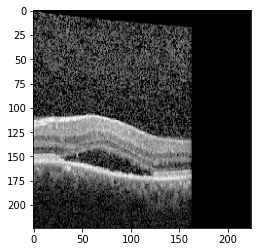

1/1 [==============================] - 0s 23ms/step
[[-2.5443318 -2.8678916  3.9461796]]
Crop VKH , 394.62
CL8574 25-03-16 LE_002015_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001005_cropped.png


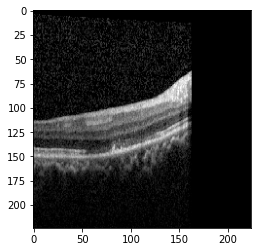

1/1 [==============================] - 0s 23ms/step
[[-2.533128 -2.857999  3.929712]]
Crop VKH , 392.97
EJ0415 20-06-11 RE_001005_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001001_cropped.png


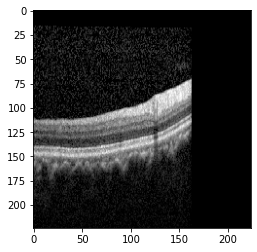

1/1 [==============================] - 0s 23ms/step
[[-2.5323224 -2.8583677  3.930117 ]]
Crop VKH , 393.01
EJ0415 20-06-11 RE_001001_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001008_cropped.png


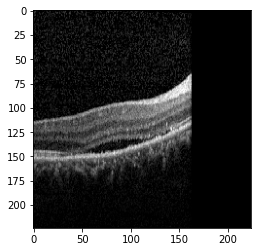

1/1 [==============================] - 0s 23ms/step
[[-2.5275319 -2.8660116  3.933664 ]]
Crop VKH , 393.37
EJ0415 20-06-11 RE_001008_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001002_cropped.png


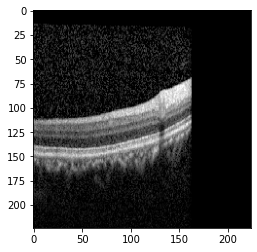

1/1 [==============================] - 0s 23ms/step
[[-2.5327845 -2.8600276  3.9318209]]
Crop VKH , 393.18
EJ0415 20-06-11 RE_001002_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_000_cropped.png


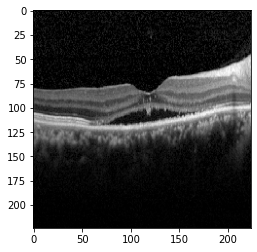

1/1 [==============================] - 0s 24ms/step
[[-2.5362718 -2.8572016  3.930252 ]]
Crop VKH , 393.03
EJ0415 20-06-11 RE_000_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001006_cropped.png


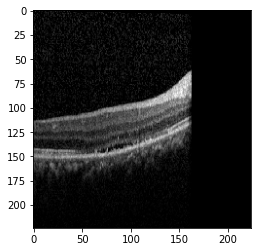

1/1 [==============================] - 0s 23ms/step
[[-2.527688  -2.8627996  3.931111 ]]
Crop VKH , 393.11
EJ0415 20-06-11 RE_001006_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001000_cropped.png


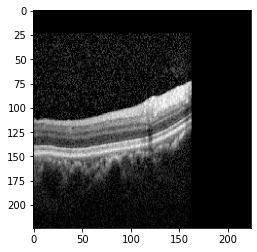

1/1 [==============================] - 0s 24ms/step
[[-2.53231   -2.858375   3.9307373]]
Crop VKH , 393.07
EJ0415 20-06-11 RE_001000_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001004_cropped.png


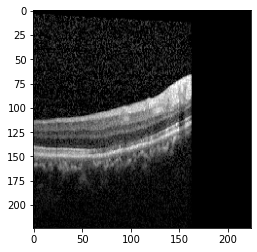

1/1 [==============================] - 0s 24ms/step
[[-2.5361435 -2.8580952  3.931772 ]]
Crop VKH , 393.18
EJ0415 20-06-11 RE_001004_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001015_cropped.png


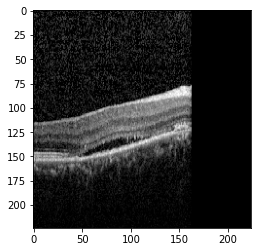

1/1 [==============================] - 0s 24ms/step
[[-2.534023 -2.861994  3.934006]]
Crop VKH , 393.40
EJ0415 20-06-11 RE_001015_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001013_cropped.png


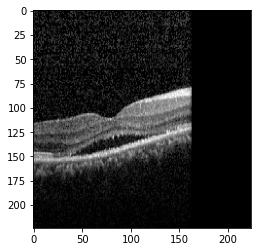

1/1 [==============================] - 0s 24ms/step
[[-2.5326648 -2.8650331  3.9355302]]
Crop VKH , 393.55
EJ0415 20-06-11 RE_001013_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001024_cropped.png


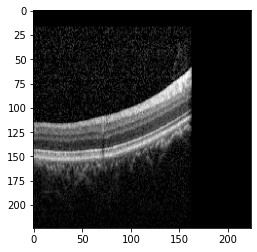

1/1 [==============================] - 0s 23ms/step
[[-2.5297737 -2.8617647  3.931527 ]]
Crop VKH , 393.15
EJ0415 20-06-11 RE_001024_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001023_cropped.png


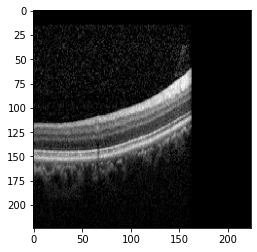

1/1 [==============================] - 0s 24ms/step
[[-2.5296526 -2.860581   3.9301038]]
Crop VKH , 393.01
EJ0415 20-06-11 RE_001023_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001019_cropped.png


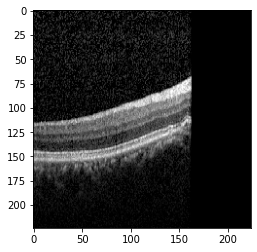

1/1 [==============================] - 0s 25ms/step
[[-2.5339034 -2.8618531  3.9338658]]
Crop VKH , 393.39
EJ0415 20-06-11 RE_001019_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001007_cropped.png


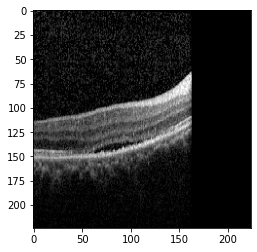

1/1 [==============================] - 0s 24ms/step
[[-2.5319896 -2.8631074  3.9335725]]
Crop VKH , 393.36
EJ0415 20-06-11 RE_001007_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001010_cropped.png


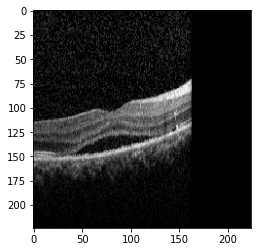

1/1 [==============================] - 0s 24ms/step
[[-2.5300071 -2.864822   3.9341013]]
Crop VKH , 393.41
EJ0415 20-06-11 RE_001010_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001009_cropped.png


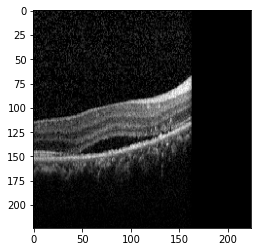

1/1 [==============================] - 0s 24ms/step
[[-2.5286071 -2.865397   3.9341304]]
Crop VKH , 393.41
EJ0415 20-06-11 RE_001009_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001018_cropped.png


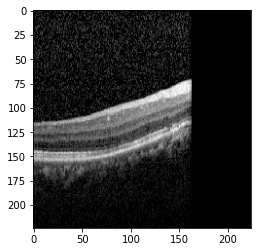

1/1 [==============================] - 0s 22ms/step
[[-2.5385168 -2.8565962  3.9315817]]
Crop VKH , 393.16
EJ0415 20-06-11 RE_001018_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001020_cropped.png


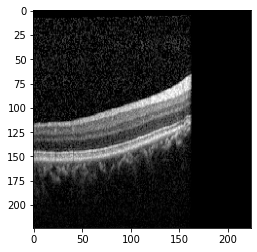

1/1 [==============================] - 0s 23ms/step
[[-2.5342934 -2.860049   3.9326172]]
Crop VKH , 393.26
EJ0415 20-06-11 RE_001020_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001016_cropped.png


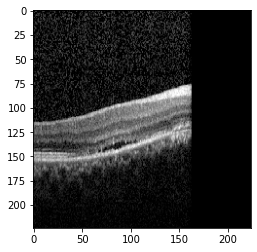

1/1 [==============================] - 0s 24ms/step
[[-2.5374672 -2.858889   3.9330075]]
Crop VKH , 393.30
EJ0415 20-06-11 RE_001016_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001014_cropped.png


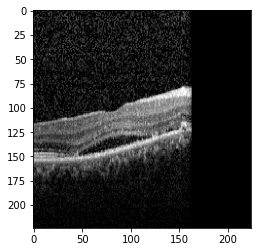

1/1 [==============================] - 0s 25ms/step
[[-2.534774 -2.864686  3.936713]]
Crop VKH , 393.67
EJ0415 20-06-11 RE_001014_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001022_cropped.png


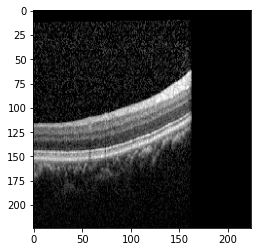

1/1 [==============================] - 0s 25ms/step
[[-2.5340478 -2.861092   3.9329426]]
Crop VKH , 393.29
EJ0415 20-06-11 RE_001022_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001011_cropped.png


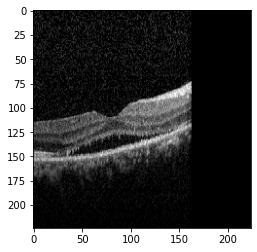

1/1 [==============================] - 0s 22ms/step
[[-2.5283601 -2.8669677  3.9351232]]
Crop VKH , 393.51
EJ0415 20-06-11 RE_001011_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001021_cropped.png


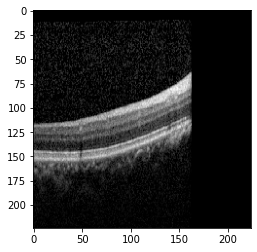

1/1 [==============================] - 0s 24ms/step
[[-2.5300608 -2.8623395  3.9320042]]
Crop VKH , 393.20
EJ0415 20-06-11 RE_001021_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001003_cropped.png


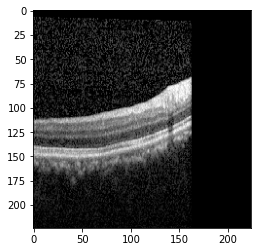

1/1 [==============================] - 0s 23ms/step
[[-2.5383785 -2.858006   3.9329665]]
Crop VKH , 393.30
EJ0415 20-06-11 RE_001003_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001012_cropped.png


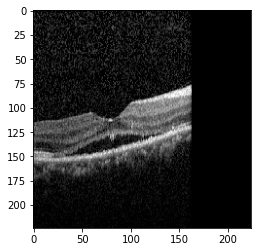

1/1 [==============================] - 0s 23ms/step
[[-2.5313952 -2.867429   3.936994 ]]
Crop VKH , 393.70
EJ0415 20-06-11 RE_001012_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_002000_cropped.png


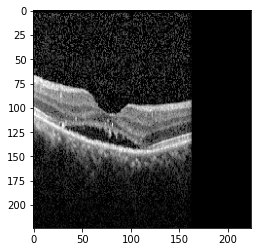

1/1 [==============================] - 0s 23ms/step
[[-2.5382624 -2.8739047  3.9451158]]
Crop VKH , 394.51
EJ0415 20-06-11 RE_002000_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_002003_cropped.png


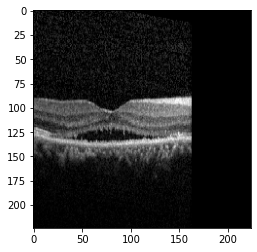

1/1 [==============================] - 0s 22ms/step
[[-2.5270913 -2.8653343  3.9330914]]
Crop VKH , 393.31
EJ0415 20-06-11 RE_002003_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_002001_cropped.png


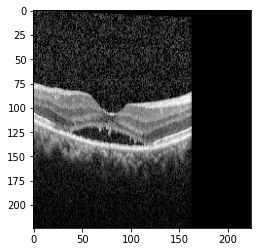

1/1 [==============================] - 0s 22ms/step
[[-2.53781   -2.864399   3.9363768]]
Crop VKH , 393.64
EJ0415 20-06-11 RE_002001_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_002002_cropped.png


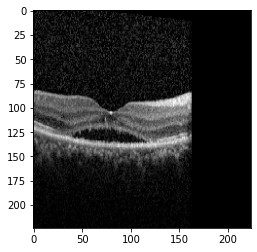

1/1 [==============================] - 0s 43ms/step
[[-2.5299518 -2.8657105  3.9343488]]
Crop VKH , 393.43
EJ0415 20-06-11 RE_002002_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_002005_cropped.png


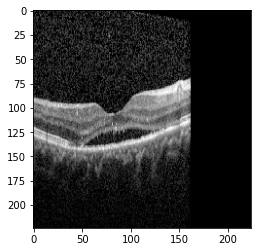

1/1 [==============================] - 0s 25ms/step
[[-2.5380237 -2.8608725  3.9339364]]
Crop VKH , 393.39
EJ0415 20-06-11 RE_002005_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_002004_cropped.png


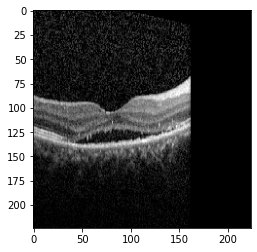

1/1 [==============================] - 0s 24ms/step
[[-2.53207   -2.864263   3.9343536]]
Crop VKH , 393.44
EJ0415 20-06-11 RE_002004_cropped.png: Crop VKH
--------------------------------------------
EJ0415 20-06-11 RE_001017_cropped.png


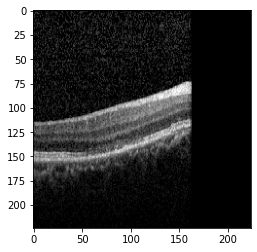

1/1 [==============================] - 0s 46ms/step
[[-2.5341346 -2.859939   3.9324152]]
Crop VKH , 393.24
EJ0415 20-06-11 RE_001017_cropped.png: Crop VKH
--------------------------------------------
EU7930 14-11 -16 LE_000001_cropped.png


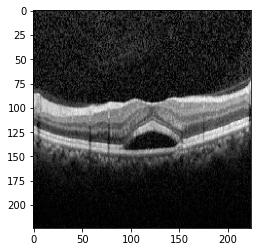

1/1 [==============================] - 0s 61ms/step
[[-2.5388114 -2.86257    3.9365401]]
Crop VKH , 393.65
EU7930 14-11 -16 LE_000001_cropped.png: Crop VKH
--------------------------------------------
EU7930 14-11 -16 LE_000002_cropped.png


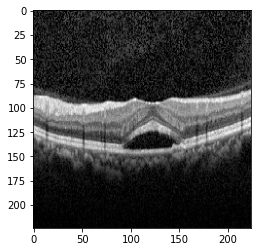

1/1 [==============================] - 0s 88ms/step
[[-2.539233  -2.862777   3.9370353]]
Crop VKH , 393.70
EU7930 14-11 -16 LE_000002_cropped.png: Crop VKH
--------------------------------------------
EU7930 14-11 -16 LE_000003_cropped.png


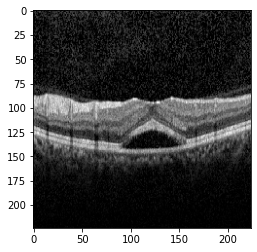

1/1 [==============================] - 0s 47ms/step
[[-2.5367882 -2.8662264  3.939419 ]]
Crop VKH , 393.94
EU7930 14-11 -16 LE_000003_cropped.png: Crop VKH
--------------------------------------------
EU7930 14-11 -16 LE_000000_cropped.png


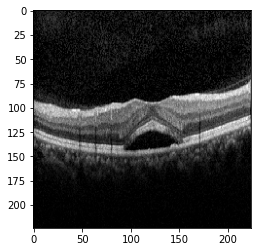

1/1 [==============================] - 0s 99ms/step
[[-2.5322678 -2.8640015  3.935437 ]]
Crop VKH , 393.54
EU7930 14-11 -16 LE_000000_cropped.png: Crop VKH
--------------------------------------------
EU7930 14-11 -16 LE_000006_cropped.png


KeyboardInterrupt: ignored

In [26]:
mypath = ('/content/drive/My Drive/2022Project/test/testcsc/')
# Label_calss = {'Crop CSC','Crop PCV','Crop VKH'}
onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]
print(onlyfiles)

# Predicting images
for file in onlyfiles:
  print(file)
  img = image.load_img(mypath+file, target_size=(img_width, img_height))

  imgplot = plt.imshow(img)
  plt.show()

  x = image.img_to_array(img)
  x /= 255.0
  x = np.expand_dims(x, axis=0)

  images = np.vstack([x])
  classes = model.predict(images)
  # classes = model.predict_classes(images)
  print(classes)
  #classes = classes[0][0]

  if np.argmax(classes) == 0:
    print("%s , %.2f" % ("Crop CSC", (classes[0][np.argmax(classes)]*100)))
    print(file + ": " + 'Crop CSC')
  
  elif np.argmax(classes) == 1:
    print("%s , %.2f" % ("Crop PCV", (classes[0][np.argmax(classes)]*100)))
    print(file + ": " + 'Crop PCV')
  
  else :
    print("%s , %.2f" % ("Crop VKH", (classes[0][np.argmax(classes)]*100)))
    print(file + ": " + 'Crop VKH')
  

  print('--------------------------------------------')

# Confusion Matrix

In [40]:
from sklearn.metrics import confusion_matrix
cm=confusion_matrix(y_test, y_pred,labels=[0,1])
print("Confusion Matrix:")
print(cm)

NameError: ignored

In [37]:
import seaborn as sns
import matplotlib.pyplot as plt
# heatmap

sns.heatmap(cm,cmap="Greens",annot=True,
            cbar_kws={"orientation":"vertical","label":"color bar"},
            xticklabels=[0,1],yticklabels=[0,1])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

ValueError: ignored